In [1]:
# For Development and debugging:
# Reload modul without restarting the kernel
%load_ext autoreload
%autoreload 2

In [2]:
import tensorflow as tf
import tensorflow_datasets as tfds
import numpy as np
import pandas as pd
pd.options.display.max_columns = None
import os
import sys
import matplotlib.pyplot as plt
import json
import copy
import seaborn as sns
sns.set_theme(style="darkgrid")

# Add EXTERNAL_LIBS_PATH to sys paths (for loading libraries)
EXTERNAL_LIBS_PATH = '/home/hhughes/Documents/Master_Thesis/Project/workspace/libs'
sys.path.insert(1, EXTERNAL_LIBS_PATH)

# Load cortum libs
import NN_interpretability as nn_inter
import Data_augmentation as data_aug
import tfds_utils

# Disable GPU
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [3]:
# Set parameters
params = {}
params['base_path'] = '/home/hhughes/Documents/Master_Thesis/Project/workspace/Interpretability'
params['model_dirs'] = {
    'BL_RIV2_test4': '/home/hhughes/Documents/Master_Thesis/Project/workspace/Interpretability/Models/BL_RIV2_test4',}
params['CMA'] = 'CMA_0'
params['cells'] = ['258520', '208516', '262920', '307720']
params['tf_ds_name'] = 'mpp_ds_normal_dmso_z_score'
params['local_tf_datasets'] = '/data/Master_Thesis_data/datasets/tensorflow_datasets'
params['score_maps_path'] = '/data/Master_Thesis_data/datasets/Score_Maps/VarGrad_IG/BL_RIV2_test4'

plot_dir = os.path.join(params['base_path'], 'Plots')
os.makedirs(plot_dir, exist_ok=True)

# Notas
- BL_t8 mide 08_H3K4ME3 usando 09_SRRM2
- It looks like cell 277420 is 2 overlaped cells.

## 1.1.- Load dataset

In [4]:
# Path where tf datasets are
dataset, ds_info = tfds.load(
    name=params['tf_ds_name'], 
    data_dir=params['local_tf_datasets'], 
    # If False, returns a dictionary with all the features
    as_supervised=False, 
    shuffle_files=False,
    with_info=True)

# Load TFDS metadata
tfds_metadata = tfds_utils.Costum_TFDS_metadata().load_metadata(ds_info.data_dir)
tfds_metadata.keys()

# Load splits
train_data, val_data = dataset['train'], dataset['validation']

In [5]:
ds_info.splits

{'test': <tfds.core.SplitInfo num_examples=371>,
 'train': <tfds.core.SplitInfo num_examples=2962>,
 'validation': <tfds.core.SplitInfo num_examples=370>}

In [6]:
ds_info.features

FeaturesDict({
    'image': Tensor(shape=(224, 224, 38), dtype=tf.float32),
    'mapobject_id_cell': Text(shape=(), dtype=tf.string),
    'target': Tensor(shape=(1,), dtype=tf.float64),
})

In [7]:
tfds_metadata['metadata_df']

,mapobject_id_cell,mapobject_id,plate_name,well_name,well_pos_y,well_pos_x,tpoint,zplane,label,is_border,plate_name_cell,well_name_cell,well_pos_y_cell,well_pos_x_cell,tpoint_cell,zplane_cell,label_cell,is_border_cell,is_mitotic,is_mitotic_labels,is_polynuclei_HeLa,is_polynuclei_HeLa_labels,is_polynuclei_184A1,is_polynuclei_184A1_labels,cell_cycle,cell_type,perturbation,duration,cell_size,00_DAPI_avg,07_H2B_avg,01_CDK9_pT186_avg,03_CDK9_avg,05_GTF2B_avg,07_SETD1A_avg,08_H3K4me3_avg,09_SRRM2_avg,10_H3K27ac_avg,11_KPNA2_MAX_avg,12_RB1_pS807_S811_avg,13_PABPN1_avg,14_PCNA_avg,15_SON_avg,16_H3_avg,17_HDAC3_avg,19_KPNA1_MAX_avg,20_SP100_avg,21_NCL_avg,01_PABPC1_avg,02_CDK7_avg,03_RPS6_avg,05_Sm_avg,07_POLR2A_avg,09_CCNT1_avg,10_POL2RA_pS2_avg,11_PML_avg,12_YAP1_avg,13_POL2RA_pS5_avg,15_U2SNRNPB_avg,18_NONO_avg,20_ALYREF_avg,21_COIL_avg,00_BG488_avg,00_BG568_avg,00_EU_avg,09_SRRM2_ILASTIK_avg,15_SON_ILASTIK_avg,cell_size_ratio,set
0,263042,263055,plate01,J16,0,0,0,0,4,0,plate01,J16,0,0,0,0,4,0,0.0,NaN,0.0,NaN,0.0,NaN,S,184A1,DMSO,720.0,8401.0,39.610201,282.212391,14.709787,34.481345,122.127518,29.408288,48.079878,56.508154,71.844750,93.999276,108.771761,157.808500,85.331438,43.616172,323.670767,128.386167,134.658031,18.805303,57.414965,26.659837,122.008728,35.669525,62.715594,133.643428,77.230008,283.199741,6.970504,92.891114,280.267874,41.649294,350.631178,356.940289,10.909557,8.600135,1.771257,431.543626,7754.927152,9285.622307,0.553571,train
1,263043,263056,plate01,J16,0,0,0,0,5,0,plate01,J16,0,0,0,0,5,0,0.0,NaN,0.0,NaN,0.0,NaN,S,184A1,DMSO,720.0,12207.0,34.884746,249.743762,14.587963,33.729957,104.787060,25.446742,35.599046,54.977671,48.061287,90.354757,97.722536,145.751775,95.141995,43.284735,308.379265,118.856662,125.728553,14.722060,52.481306,21.451844,122.747143,30.401393,53.993867,124.670275,81.619971,272.290742,9.256049,120.165421,267.314880,39.224038,322.807908,387.219828,10.134157,7.880916,1.749512,461.474236,8818.934136,11041.621938,0.598214,test
2,263044,263057,plate01,J16,0,0,0,0,6,0,plate01,J16,0,0,0,0,6,0,0.0,NaN,0.0,NaN,0.0,NaN,G1,184A1,DMSO,720.0,15734.0,31.429217,184.722779,7.892179,19.263491,81.864454,23.929299,29.536900,39.606383,39.047856,77.348039,12.910413,149.859577,42.855445,25.530594,219.118552,102.575527,125.740665,5.120140,27.724444,24.187370,49.106275,29.276163,35.680201,85.295744,60.602490,232.305672,8.395510,124.383677,193.414682,36.115297,273.154826,252.115717,7.854372,8.116748,1.803605,372.570739,5740.956972,7330.808440,0.723214,train
3,263045,263058,plate01,J16,0,0,0,0,7,0,plate01,J16,0,0,0,0,7,0,0.0,NaN,0.0,NaN,0.0,NaN,S,184A1,DMSO,720.0,15767.0,43.349090,241.460906,18.110119,44.601291,122.976267,40.604674,48.760110,58.076779,77.012867,121.283321,104.755645,159.792550,84.807594,43.961097,319.584115,120.314566,120.470444,25.555966,60.243330,21.220701,140.246102,27.944981,60.354207,169.718381,102.371663,264.648847,10.370258,116.424263,268.396552,43.573547,351.399875,357.762600,10.338172,7.913029,1.773024,369.910382,8085.528636,9678.381810,0.660714,test
4,263047,263060,plate01,J16,0,0,0,0,9,0,plate01,J16,0,0,0,0,9,0,0.0,NaN,0.0,NaN,0.0,NaN,G1,184A1,DMSO,720.0,11930.0,28.164459,149.241408,27.710272,72.874109,148.002903,51.391368,56.976488,116.255474,56.907744,66.943473,97.452245,187.995952,53.530015,60.917580,134.426297,121.980833,121.369045,59.501243,54.852952,26.389251,162.722979,36.026263,79.981471,237.625004,150.247531,255.964144,18.029298,188.560486,192.446750,66.494555,242.252349,174.614508,9.784177,8.899475,1.970130,552.887343,15128.646940,13469.590947,0.625000,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3698,266516,266565,plate01,J12,5,4,0,0,44,0,plate01,J12,5,4,0,0,44,0,0.0,NaN,0.0,NaN,0.0,NaN,G2,184A1,normal,NaN,19401.0,38.974759,76.047797,17.563898,36.

In [8]:
# take a look into the bigger cels also
big_cells = tfds_metadata['metadata_df'].sort_values(by='cell_size_ratio', ascending=False).head(21)[['mapobject_id_cell']]
big_cells = big_cells.values.reshape(-1).astype('str')

In [9]:
channels_df = tfds_metadata['channels_df']
channel_names = [c.split("_")[1:] for c in channels_df.name.values]
channel_names = ["_".join(c) for c in channel_names]
channels_df['channel_name'] = channel_names
channels_df

,original_channel_id,name,train_98_percentile,train_mean_after_clipping,train_stddev_after_clipping,type,TFDS_channel_id,channel_name
0,0.0,00_DAPI,69.300003,29.277029,14.289816,input,0.0,DAPI
1,1.0,07_H2B,310.299988,128.472672,67.600372,input,1.0,H2B
2,2.0,01_CDK9_pT186,46.889076,10.841645,10.662010,input,2.0,CDK9_pT186
3,3.0,03_CDK9,90.797798,24.890778,20.744143,input,3.0,CDK9
4,4.0,05_GTF2B,188.166107,76.841652,45.399426,input,4.0,GTF2B
5,5.0,07_SETD1A,91.989853,20.670820,20.641857,input,5.0,SETD1A
6,6.0,08_H3K4me3,105.921074,34.419682,24.227314,input,6.0,H3K4me3
7,7.0,09_SRRM2,273.374664,39.124294,58.492748,input,7.0,SRRM2
8,8.0,10_H3K27ac,175.104874,59.614319,42.007408,input,8.0,H3K27ac
9,9.0,11_KPNA2_MAX,115.093430,41.293499,23.342470,input,9.0,KPNA2_MAX


In [10]:
# Load model parameters
temp_key = list(params['model_dirs'].keys())[0]
temp_path = os.path.join(params['model_dirs'][temp_key], 'parameters.json')
with open(temp_path, 'r') as file:
    model_params = json.load(file)
print(model_params.keys())

dict_keys(['parameters_file_path', 'external_libs_path', 'model_name', 'custom_model_class', 'pre_training', 'dense_reg', 'conv_reg', 'bias_l2_reg', 'number_of_epochs', 'early_stop_patience', 'loss', 'learning_rate', 'BATCH_SIZE', 'verbose_level', 'model_path', 'basename', 'base_path', 'clean_model_dir', 'tf_ds_name', 'input_channels', 'shuffle_files', 'local_tf_datasets', 'random_horizontal_flipping', 'random_90deg_rotations', 'CenterZoom', 'CenterZoom_mode', 'Random_channel_intencity', 'RCI_dist', 'RCI_mean', 'RCI_stddev', 'RCI_rescale_cte', 'log_path', 'log_file', 'tensorboard', 'seed', 'disable_gpu', 'set_memory_growth', 'cell_size_ratio_mean', 'cell_size_ratio_stddev', 'cell_size_ratio_low_bound'])


In [11]:
# Get input_ids
selected_channels = model_params['input_channels']
n_channels = len(selected_channels)
input_ids = np.array(channels_df.set_index(['name']).loc[selected_channels].TFDS_channel_id.values)
input_ids = np.sort(input_ids.astype(np.int16))
input_channel_names = channels_df.sort_values(by='TFDS_channel_id').set_index('TFDS_channel_id').loc[range(n_channels)].name.values
msg = 'Input channel ids:\n{}'.format(input_ids)
print(msg)

Input channel ids:
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32]


## 1.2.- Load Model Data

In [12]:
#models_path = os.path.join(params['base_path'], 'Models', params['model_dir'])
targets_df = pd.DataFrame()
for i, model in enumerate(params['model_dirs'].keys()):
    model_dir = params['model_dirs'][model]
    print('Reading predicted values for model: ', model)
    temp_path = os.path.join(model_dir, 'targets_'+params['CMA']+'.csv')
    with open(temp_path, 'r') as file:
        temp_df = pd.read_csv(file)
    temp_df = temp_df.drop(['y - y_hat'], axis=1)
    prediction_name = 'y_hat'+'_'+model
    temp_df[prediction_name] = temp_df.y_hat
    temp_df = temp_df.drop(['y_hat'], axis=1)
    if i == 0:
        targets_df = temp_df.copy()
    else:
        temp_df = temp_df[['mapobject_id_cell', prediction_name]]
        targets_df = targets_df.merge(temp_df, 
                                      left_on='mapobject_id_cell',
                                      right_on='mapobject_id_cell',
                                      how='left')
targets_df.mapobject_id_cell = targets_df.mapobject_id_cell.astype('string')
mask = targets_df.mapobject_id_cell.isin(np.array(params['cells']))
round(targets_df[mask], 2)

Reading predicted values for model:  BL_RIV2_test4


,y,mapobject_id_cell,set,perturbation,cell_cycle,y_hat_BL_RIV2_test4
18,169.75,258520,train,normal,G1,280.56
2934,513.50,262920,train,normal,G2,497.50
3129,400.17,208516,val,normal,S,418.22
3133,366.16,307720,val,DMSO,G1,331.48


In [13]:
# Devide cell in Low TR medium and High
#low_per = targets_df.y.quantile(0.2)
#high_per = targets_df.y.quantile(0.8)
#print(low_per, high_per)
y_std = targets_df.y.std()
y_mean = targets_df.y.mean()
print(y_mean, y_std)
low_per = y_mean-y_std
high_per = y_mean+y_std
print(low_per, high_per)

mask_low = targets_df.y <= low_per
n_low = np.sum((mask_low).values)
mask_avg = (targets_df.y > low_per) & (targets_df.y < high_per)
n_avg = np.sum((mask_avg).values)
mask_high = targets_df.y >= high_per
n_high = np.sum((mask_high).values)
print(n_low, n_avg, n_high)
n_samples = n_low + n_avg + n_high
print(n_low/n_samples, n_avg/n_samples, n_high/n_samples)

# Save TR level
targets_df['TR_Level'] = 'Avg_TR'
temp_idxs = targets_df[mask_low].index
targets_df.loc[temp_idxs, 'TR_Level'] = 'Low_TR'
temp_idxs = targets_df[mask_high].index
targets_df.loc[temp_idxs, 'TR_Level'] = 'High_TR'
targets_df

377.2833369803886 60.71855957335795
316.56477740703065 438.0018965537465
532 2626 545
0.14366729678638943 0.7091547394004861 0.1471779638131245


,y,mapobject_id_cell,set,perturbation,cell_cycle,y_hat_BL_RIV2_test4,TR_Level
0,337.603180,305670,train,DMSO,G1,393.687317,Avg_TR
1,436.179108,248989,train,DMSO,G1,432.883423,Avg_TR
2,344.612427,212764,train,normal,G1,340.201813,Avg_TR
3,397.731262,383254,train,normal,G1,351.875275,Avg_TR
4,251.880371,287059,train,DMSO,G1,375.951721,Low_TR
...,...,...,...,...,...,...,...
3698,400.196350,321028,test,normal,G1,418.039886,Avg_TR
3699,414.214355,194787,test,normal,S,404.132172,Avg_TR
3700,354.966553,259718,test,normal,G1,350.943604,Avg_TR
3701,425.607788,351947,test,normal,G1,344.580719,Avg_TR


In [14]:
# Select cells to plot
#temp_df = targets_df.copy()
#temp_df['y - y_hat_BL'] = (temp_df.y - temp_df.y_hat_BL).abs()
#mask = (temp_df.y < high_per) & (temp_df.y > low_per)
#temp_df[mask].sort_values('y - y_hat_BL').head(50)

## 1.3.- Load score maps info

In [15]:
# load score maps metadata
score_maps_dir = os.path.join(params['score_maps_path'], 'data')
temp_path = os.path.join(params['score_maps_path'], 'score_map_stddev.csv')
score_map_stddev = pd.read_csv(temp_path)
score_map_stddev.mapobject_id_cell = score_map_stddev.mapobject_id_cell.astype('string')
# Add more info
score_map_stddev = score_map_stddev.merge(targets_df,
                                          left_on='mapobject_id_cell',
                                          right_on='mapobject_id_cell',
                                          how='left')
score_map_stddev

,00_DAPI,07_H2B,01_CDK9_pT186,03_CDK9,05_GTF2B,07_SETD1A,08_H3K4me3,09_SRRM2,10_H3K27ac,11_KPNA2_MAX,12_RB1_pS807_S811,13_PABPN1,14_PCNA,15_SON,16_H3,17_HDAC3,19_KPNA1_MAX,20_SP100,21_NCL,01_PABPC1,02_CDK7,03_RPS6,05_Sm,07_POLR2A,09_CCNT1,10_POL2RA_pS2,11_PML,12_YAP1,13_POL2RA_pS5,15_U2SNRNPB,18_NONO,20_ALYREF,21_COIL,Total_cell_stddev,Model,mapobject_id_cell,y,set,perturbation,cell_cycle,y_hat_BL_RIV2_test4,TR_Level
0,0.021712,0.026482,0.034386,0.023784,0.045908,0.049194,0.030905,0.047514,0.017180,0.019592,0.020066,0.039448,0.030083,0.029423,0.024492,0.038400,0.014057,0.022829,0.034143,0.013831,0.023057,0.032123,0.029989,0.032683,0.024461,0.083143,0.020679,0.018072,0.030835,0.032180,0.031826,0.021930,0.035594,392.96356,BL_RIV2_test4,305670,337.603180,train,DMSO,G1,393.687317,Avg_TR
1,0.020170,0.035940,0.050272,0.034937,0.049571,0.042441,0.032318,0.038210,0.016147,0.021924,0.017494,0.034490,0.017150,0.016407,0.025257,0.043612,0.023508,0.017609,0.038461,0.018961,0.023243,0.043732,0.034100,0.026398,0.022588,0.072613,0.015439,0.021048,0.032297,0.031554,0.037500,0.017921,0.026687,552.68740,BL_RIV2_test4,248989,436.179108,train,DMSO,G1,432.883423,Avg_TR
2,0.018793,0.026389,0.027446,0.024622,0.054141,0.034503,0.025501,0.042191,0.019537,0.022951,0.015158,0.038159,0.024055,0.030342,0.036098,0.028436,0.016536,0.018669,0.059169,0.020644,0.017095,0.038339,0.036606,0.022499,0.026012,0.074763,0.023761,0.013734,0.033404,0.039390,0.023187,0.028318,0.039553,297.79926,BL_RIV2_test4,212764,344.612427,train,normal,G1,340.201813,Avg_TR
3,0.018321,0.023612,0.025744,0.026229,0.053796,0.034834,0.026469,0.044233,0.020683,0.020101,0.016427,0.035858,0.024782,0.029504,0.027898,0.025253,0.016524,0.018942,0.057481,0.025475,0.016528,0.036689,0.042502,0.021924,0.029250,0.073168,0.027098,0.016238,0.031047,0.038315,0.025432,0.026359,0.043286,249.73418,BL_RIV2_test4,383254,397.731262,train,normal,G1,351.875275,Avg_TR
4,0.023292,0.033220,0.032970,0.025329,0.039393,0.038383,0.028499,0.042313,0.023314,0.031905,0.016029,0.039325,0.024122,0.020118,0.034232,0.048438,0.023699,0.019179,0.030445,0.022138,0.022979,0.047453,0.027604,0.026548,0.020032,0.095404,0.018252,0.012396,0.029025,0.028063,0.028167,0.020461,0.027272,347.07455,BL_RIV2_test4,287059,251.880371,train,DMSO,G1,375.951721,Low_TR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3327,0.019426,0.030366,0.022787,0.023246,0.049333,0.034073,0.025676,0.037867,0.021551,0.023349,0.015895,0.034583,0.023766,0.031523,0.053048,0.035470,0.015835,0.018093,0.051045,0.018591,0.016241,0.033114,0.035012,0.017247,0.025734,0.090043,0.028232,0.016953,0.035236,0.037126,0.018976,0.030353,0.030210,294.40080,BL_RIV2_test4,306902,274.466705,val,normal,G1,315.852448,Low_TR
3328,0.017834,0.028148,0.025597,0.025700,0.053045,0.032745,0.027031,0.045852,0.023336,0.023731,0.016909,0.033608,0.028076,0.030948,0.033905,0.026593,0.016133,0.018185,0.054248,0.024867,0.017132,0.031533,0.036060,0.021271,0.028650,0.075446,0.025436,0.016183,0.033214,0.040286,0.022274,0.027669,0.038357,212.69305,BL_RIV2_test4,235366,300.817352,val,DMSO,G1,328.528625,Low_TR
3329,0.021248,0.027665,0.035129,0.024183,0.048275,0.036643,0.025327,0.043417,0.015233,0.019087,0.015372,0.038304,0.019109,0.027803,0.022688,0.033255,0.019688,0.020126,0.056012,0.024065,0.021783,0.047435,0.039200,0.027721,0.024606,0.067355,0.018768,0.016134,0.028614,0.034513,0.030528,0.025838,0.044877,429.77734,BL_RIV2_test4,205756,428.364258,val,normal,G1,425.350403,Avg_TR
3330,0.024374,0.032586,0.028637,0.021495,0.047104,0.034736,0.028599,0.042556,0.022521,0.019369,0.021136,0.037280,0.038122,0.026375,0.027389,0.034838,0.020816,0.023816,0.034389,0.017372,0.026687,0.047644,0.030360,0.029540,0.024153,0.067539,0.019210,0.014888,0.033522,0.028205,0.031787,0.022208,0.040747,340.76633,BL_RIV2_test4,348034,422.460754,val,DMSO,S,404.251709,Avg_TR


## 1.4.- Load a sample of cells

Opening cell: 258520, 1/4
['train']


Opening cell: 262920, 2/4
['train']


Opening cell: 208516, 3/4
['val']
Opening cell: 307720, 4/4
['val']


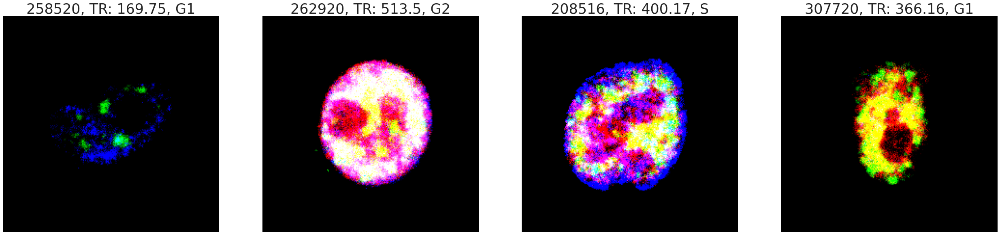

In [16]:
# Load cell, compute its Score map and save it
score_maps_dir = os.path.join(params['score_maps_path'], 'data')
#params['cells'] = big_cells
n_cells = len(params['cells'])
big_cells
plt.figure(figsize=(n_cells*11,10))
dss = [train_data, val_data]
ds_names = ['train', 'val']
cell_count = 0
cells = {}
for ds, dsn in zip(dss, ds_names):
    for cell in ds:
        # get cell id
        cell_id = cell['mapobject_id_cell'].numpy()
        cell_id = str(cell_id.decode())

        if cell_id in params['cells']:
            cell_count += 1
            print('Opening cell: {}, {}/{}'.format(cell_id, cell_count, n_cells))
            
            cells[cell_id+'_img'] = cell['image'].numpy()
            cells[cell_id+'_img'] = cells[cell_id+'_img'][:,:,input_ids].astype(np.float32)
            
            cells[cell_id+'_mask'] = cell['image'].numpy()
            cells[cell_id+'_mask'] = cells[cell_id+'_mask'][:,:,-1]
            cells[cell_id+'_mask'] = cells[cell_id+'_mask'].astype(np.bool)
            
            # load score map
            temp_path = os.path.join(score_maps_dir, cell_id+'.npy')
            cells[cell_id+'_sm'] = np.load(temp_path)
            
            # Plot cells
            temp_img = cells[cell_id+'_img'][:,:,10:13]
            plt.subplot(1, n_cells, cell_count)

            # Get TR
            TR = cell['target'].numpy()[0]
            # get cc
            mask = targets_df.mapobject_id_cell == cell_id
            cc = targets_df[mask].cell_cycle.values[0]
            print(targets_df[mask].set.values)

            nn_inter.plot_cell(img=temp_img, title=cell_id+', TR: '+str(round(TR, 2))+', '+cc, title_fontsize=35)

In [17]:
from scipy import ndimage
from scipy.spatial.distance import directed_hausdorff

def compute_channel_difference_matrix(score_map, cell_mask, metric='mae'):
    n_channels = score_map.shape[-1]
    dist_mtx = np.zeros((n_channels, n_channels))
    N = cell_mask.sum()
    for i in range(n_channels):
        for j in range(n_channels):
            if metric == 'mae':
                dist_mtx[i,j] = (1 / N) * np.sum(np.abs(score_map[:,:,i] - score_map[:,:,j]))
            elif metric == 'hausdorff':
                dist_mtx[i,j] = directed_hausdorff(score_map[:,:,i], score_map[:,:,j])[0]
    
    # normalize values
    norm_param = dist_mtx.sum()
    dist_mtx /= norm_param
    
    return dist_mtx

def apply_gaussin_filter(img=None,  sigma=1):
    return ndimage.gaussian_filter(img, sigma)

def standardize_img(img, img_mask):
    channel_mean = img[img_mask].mean(axis=0)
    channel_stddev = img[img_mask].std(axis=0)

    img[img_mask] = img[img_mask] - channel_mean
    img[img_mask] = img[img_mask] / channel_stddev
    
    return img

def apply_percentile_clipping(img, img_mask, p=98):

    percentile_vector = np.percentile(img[img_mask], q=p, axis=0)

    n_channels = img.shape[-1]
    for c in range(n_channels):
        mask = (img[:,:,c] >= percentile_vector[c])
        img[:,:,c][mask] = percentile_vector[c]
        
    return img

def get_channels_dist(c1, c2, cell_mask, metric):
    N = cell_mask.sum()
    if metric == 'mae':
        return (1 / N) * np.sum(np.abs(c1 - c2))
    elif metric == 'hausdorff':
        return directed_hausdorff(c1, c2)[0]
    
def get_score_map_similarity(temp_score, temp_cell_img, cell_mask, metric='mae'):
    INF = np.inf
    n_channels =  temp_score.shape[-1]
    # similarity between score_map channels and score_map channels
    top_sim_sm_channel_id_dict = {}
    top_sim_sm_channel_dist_dict = {}
    # similarity between score_map channels and cell_img channels
    top_sim_channel_id_dict = {}
    most_sim_channel_dist = {}
    # dataframes to store score map channel dist
    temp_sm_to_sm = {}
    temp_sm_to_ci = {}
    
    for key in range(3):
        top_sim_sm_channel_id_dict[key] = []
        top_sim_sm_channel_dist_dict[key] = []
        
        top_sim_channel_id_dict[key] = []
        most_sim_channel_dist[key] = []
    
    for i in range(n_channels):
        sm_chanel_dist = []
        chanel_dist = []
        for j in range(n_channels):
            if i == j:
                # distance between a channel and itself is 0, therefore assign it INF
                sm_chanel_dist.append(INF)
            else:
                sm_chanel_dist.append(get_channels_dist(temp_score[:,:,i], temp_score[:,:,j], cell_mask, metric))
            # distances between the score_map channel j and cell_img channels
            chanel_dist.append(get_channels_dist(temp_score[:,:,i], temp_cell_img[:,:,j], cell_mask, metric))
            
        for key in range(3):
            # save the most similar score_map channel to channel i
            top_sim_sm_channel_id_dict[key].append(np.argsort(sm_chanel_dist)[key])
            top_sim_sm_channel_dist_dict[key].append(np.sort(sm_chanel_dist)[key])
            # save the most similar cell_img channel to score_map channel i
            top_sim_channel_id_dict[key].append(np.argsort(chanel_dist)[key])
            most_sim_channel_dist[key].append(np.sort(chanel_dist)[key])
    
    columns = [cn+'_idx' for cn in input_channel_names] + [cn+'_dist' for cn in input_channel_names]
    for key in range(3):
        temp_arr = np.array(top_sim_sm_channel_id_dict[key] + top_sim_sm_channel_dist_dict[key]).reshape((1, -1))
        temp_sm_to_sm[key] = pd.DataFrame(temp_arr, columns=columns)
        temp_arr = np.array(top_sim_channel_id_dict[key] + most_sim_channel_dist[key]).reshape((1, -1))
        temp_sm_to_ci[key] = pd.DataFrame(temp_arr, columns=columns)
    
    return temp_sm_to_sm, temp_sm_to_ci

In [18]:
metric = 'mae'
top_sm_to_sm_dfs = {}
top_sm_to_ci_dfs = {}
for key in range(3):
    top_sm_to_sm_dfs[key] = pd.DataFrame()
    top_sm_to_ci_dfs[key] = pd.DataFrame()

mask = tfds_metadata['metadata_df'].set == 'test'
params['cells'] = tfds_metadata['metadata_df'][~mask].mapobject_id_cell.unique().astype('str')

# Load cell, compute its Score map and save it
score_maps_dir = os.path.join(params['score_maps_path'], 'data')
#params['cells'] = big_cells
n_cells = len(params['cells'])
dss = [train_data, val_data]
ds_names = ['train', 'val']
cell_count = 0
for ds, dsn in zip(dss, ds_names):
    for cell in ds:
        # get cell id
        cell_id = cell['mapobject_id_cell'].numpy()
        cell_id = str(cell_id.decode())

        if cell_id in params['cells']:
            cell_count += 1
            print('Loading cell: {}, {}/{}'.format(cell_id, cell_count, n_cells))
            
            cell_img = cell['image'].numpy()
            cell_img = cell_img[:,:,input_ids].astype(np.float32)
            
            cell_mask = cell['image'].numpy()
            cell_mask = cell_mask[:,:,-1]
            cell_mask = cell_mask.astype(np.bool)
            
            # load score map
            temp_path = os.path.join(score_maps_dir, cell_id+'.npy')
            score_map = np.load(temp_path)
            
            # get channel similarity
            # preprocess
            score_map = standardize_img(score_map, cell_mask)
            cell_img = standardize_img(cell_img, cell_mask)
            
            # get sim
            smsm_dfs, smci_dfs = get_score_map_similarity(score_map, cell_img, cell_mask, metric)
            for key in range(3):
                smsm_dfs[key]['mapobject_id_cell'] = cell_id
                smci_dfs[key]['mapobject_id_cell'] = cell_id
                
                top_sm_to_sm_dfs[key] = pd.concat((top_sm_to_sm_dfs[key], smsm_dfs[key]), axis=0, ignore_index=True)
                top_sm_to_ci_dfs[key] = pd.concat((top_sm_to_ci_dfs[key], smci_dfs[key]), axis=0, ignore_index=True)

Loading cell: 305670, 1/3332
Loading cell: 248989, 2/3332
Loading cell: 212764, 3/3332
Loading cell: 383254, 4/3332
Loading cell: 287059, 5/3332
Loading cell: 226855, 6/3332
Loading cell: 366430, 7/3332
Loading cell: 266507, 8/3332
Loading cell: 337246, 9/3332
Loading cell: 235351, 10/3332
Loading cell: 305662, 11/3332
Loading cell: 307724, 12/3332
Loading cell: 221647, 13/3332
Loading cell: 194797, 14/3332
Loading cell: 260099, 15/3332
Loading cell: 321007, 16/3332
Loading cell: 215865, 17/3332
Loading cell: 305667, 18/3332
Loading cell: 258520, 19/3332
Loading cell: 195221, 20/3332
Loading cell: 350656, 21/3332
Loading cell: 257458, 22/3332
Loading cell: 359335, 23/3332
Loading cell: 195549, 24/3332
Loading cell: 329080, 25/3332
Loading cell: 202822, 26/3332
Loading cell: 359020, 27/3332
Loading cell: 319175, 28/3332
Loading cell: 256525, 29/3332
Loading cell: 287403, 30/3332
Loading cell: 373523, 31/3332
Loading cell: 351026, 32/3332
Loading cell: 319183, 33/3332
Loading cell: 26854

In [19]:
# Save data
#for key in range(3):
#    temp_name = os.path.join('./Data', 'top_'+str(key)+'_sm_to_ci_dfs.csv')
#    with open(temp_name, 'w') as file:
#        top_sm_to_ci_dfs[key].to_csv(file, index=False)
        
#    temp_name = os.path.join('./Data', 'top_'+str(key)+'_sm_to_sm_dfs.csv')
#    with open(temp_name, 'w') as file:
#        top_sm_to_sm_dfs[key].to_csv(file, index=False)

In [20]:
top_sm_to_ci_dfs[0]

,00_DAPI_idx,07_H2B_idx,01_CDK9_pT186_idx,03_CDK9_idx,05_GTF2B_idx,07_SETD1A_idx,08_H3K4me3_idx,09_SRRM2_idx,10_H3K27ac_idx,11_KPNA2_MAX_idx,12_RB1_pS807_S811_idx,13_PABPN1_idx,14_PCNA_idx,15_SON_idx,16_H3_idx,17_HDAC3_idx,19_KPNA1_MAX_idx,20_SP100_idx,21_NCL_idx,01_PABPC1_idx,02_CDK7_idx,03_RPS6_idx,05_Sm_idx,07_POLR2A_idx,09_CCNT1_idx,10_POL2RA_pS2_idx,11_PML_idx,12_YAP1_idx,13_POL2RA_pS5_idx,15_U2SNRNPB_idx,18_NONO_idx,20_ALYREF_idx,21_COIL_idx,00_DAPI_dist,07_H2B_dist,01_CDK9_pT186_dist,03_CDK9_dist,05_GTF2B_dist,07_SETD1A_dist,08_H3K4me3_dist,09_SRRM2_dist,10_H3K27ac_dist,11_KPNA2_MAX_dist,12_RB1_pS807_S811_dist,13_PABPN1_dist,14_PCNA_dist,15_SON_dist,16_H3_dist,17_HDAC3_dist,19_KPNA1_MAX_dist,20_SP100_dist,21_NCL_dist,01_PABPC1_dist,02_CDK7_dist,03_RPS6_dist,05_Sm_dist,07_POLR2A_dist,09_CCNT1_dist,10_POL2RA_pS2_dist,11_PML_dist,12_YAP1_dist,13_POL2RA_pS5_dist,15_U2SNRNPB_dist,18_NONO_dist,20_ALYREF_dist,21_COIL_dist,mapobject_id_cell
0,7.0,13.0,13.0,13.0,13.0,7.0,7.0,7.0,17.0,13.0,7.0,13.0,7.0,13.0,19.0,7.0,13.0,17.0,18.0,13.0,13.0,18.0,13.0,7.0,7.0,7.0,26.0,7.0,13.0,13.0,7.0,13.0,13.0,0.501626,0.789199,0.551689,0.688176,0.730774,0.315784,0.403398,0.526712,0.901557,0.891455,0.682501,0.424931,0.827172,0.425942,0.840983,0.506300,0.577653,0.362413,0.710080,0.849466,0.513694,0.627317,0.648460,0.383603,0.511652,0.493677,0.576491,0.587088,0.844734,0.827235,0.390612,0.821544,0.595295,305670
1,0.0,7.0,7.0,13.0,26.0,7.0,7.0,7.0,19.0,13.0,13.0,13.0,26.0,13.0,19.0,13.0,16.0,17.0,18.0,19.0,13.0,18.0,18.0,7.0,7.0,7.0,26.0,13.0,13.0,13.0,7.0,19.0,13.0,0.871873,0.683642,0.600870,0.793472,0.943983,0.491463,0.520401,0.567847,0.859073,0.868057,0.781464,0.647913,0.931767,0.785215,0.879332,0.780583,0.807465,0.417418,0.821819,0.637667,0.710261,0.778430,0.706029,0.495646,0.562013,0.670297,0.629910,0.835069,0.943492,0.938495,0.589085,0.881716,0.832150,248989
2,13.0,19.0,17.0,13.0,18.0,7.0,7.0,7.0,17.0,19.0,18.0,7.0,17.0,13.0,17.0,7.0,17.0,17.0,18.0,18.0,17.0,18.0,18.0,7.0,7.0,13.0,17.0,17.0,17.0,19.0,17.0,17.0,18.0,0.801513,0.849766,0.805516,0.777982,0.755844,0.459520,0.771509,0.761594,0.842822,0.834687,0.885616,0.665548,0.823476,0.526012,0.832371,0.726883,0.837921,0.404157,0.530551,0.664622,0.887167,0.504745,0.594271,0.703942,0.674895,0.725116,0.554056,0.802284,0.880540,0.936837,0.788000,0.884516,0.693968,212764
3,18.0,17.0,18.0,13.0,18.0,13.0,13.0,13.0,17.0,17.0,18.0,13.0,17.0,13.0,17.0,13.0,18.0,17.0,18.0,18.0,18.0,18.0,18.0,18.0,13.0,13.0,17.0,18.0,17.0,18.0,18.0,13.0,18.0,0.739674,0.861669,0.836540,0.618136,0.616755,0.438670,0.811510,0.622983,0.751945,0.860450,0.794219,0.626583,0.848792,0.455396,0.705292,0.684240,0.749318,0.384316,0.448645,0.671322,0.783875,0.442830,0.607930,0.611631,0.542116,0.631460,0.482049,0.749222,0.772267,0.869557,0.775795,0.866290,0.637226,383254
4,0.0,7.0,2.0,3.0,14.0,7.0,7.0,7.0,13.0,7.0,7.0,7.0,17.0,13.0,14.0,7.0,16.0,17.0,17.0,19.0,7.0,17.0,7.0,7.0,13.0,7.0,26.0,27.0,9.0,13.0,7.0,13.0,7.0,0.847815,0.636574,0.568500,0.901702,0.990726,0.502639,0.466533,0.466712,0.944356,0.864020,0.774553,0.589339,0.923695,0.564552,0.914486,0.857084,0.851319,0.361140,0.897497,0.765723,0.813240,0.837218,0.644537,0.401350,0.627746,0.503605,0.535497,0.827647,0.989982,1.017710,0.506096,0.935870,0.651302,287059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3327,26.0,19.0,26.0,13.0,18.0,13.0,13.0,13.0,19.0,19.0,17.0,13.0,19.0,13.0,19.0,15.0,16.0,17.0,18.0,18.0,19.0,18.0,18.0,13.0,13.0,13.0,26.0,13.0,26.0,19.0,13.0,13.0,18.0,0.914878,0.844207,0.793132,0.689091,0.870161,0.463271,0.706615,0.796698,0.821470,0.831922,0.919198,0.718099,0.834422,0.467727,0.841798,0.784603,0.829010,0.373385,0.580622,0.761106,0.919950,0.533442,0.751000,0.766125,0.605085,0.703787,0.517629,0.729415,0.822979,0.875880,0.763974,0.867166,0.730644

In [21]:
pd.options.display.max_columns = 17
columns = top_sm_to_ci_dfs[0].columns
columns = ['mapobject_id_cell'] + [col for col in columns if '_idx' in col]
temp_df = top_sm_to_ci_dfs[0][columns]

temp_df.astype('int32')

,mapobject_id_cell,00_DAPI_idx,07_H2B_idx,01_CDK9_pT186_idx,03_CDK9_idx,05_GTF2B_idx,07_SETD1A_idx,08_H3K4me3_idx,...,10_POL2RA_pS2_idx,11_PML_idx,12_YAP1_idx,13_POL2RA_pS5_idx,15_U2SNRNPB_idx,18_NONO_idx,20_ALYREF_idx,21_COIL_idx
0,305670,7,13,13,13,13,7,7,...,7,26,7,13,13,7,13,13
1,248989,0,7,7,13,26,7,7,...,7,26,13,13,13,7,19,13
2,212764,13,19,17,13,18,7,7,...,13,17,17,17,19,17,17,18
3,383254,18,17,18,13,18,13,13,...,13,17,18,17,18,18,13,18
4,287059,0,7,2,3,14,7,7,...,7,26,27,9,13,7,13,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3327,306902,26,19,26,13,18,13,13,...,13,26,13,26,19,13,13,18
3328,235366,18,17,18,13,18,13,18,...,17,17,18,17,17,18,17,18
3329,205756,7,7,7,3,18,13,7,...,7,26,13,13,13,13,13,18
3330,348034,13,13,13,13,13,13,13,...,13,26,13,13,13,13,13,13


# Similarity between score_maps channels and cell_image channels

[13 17  7 18 26 19]


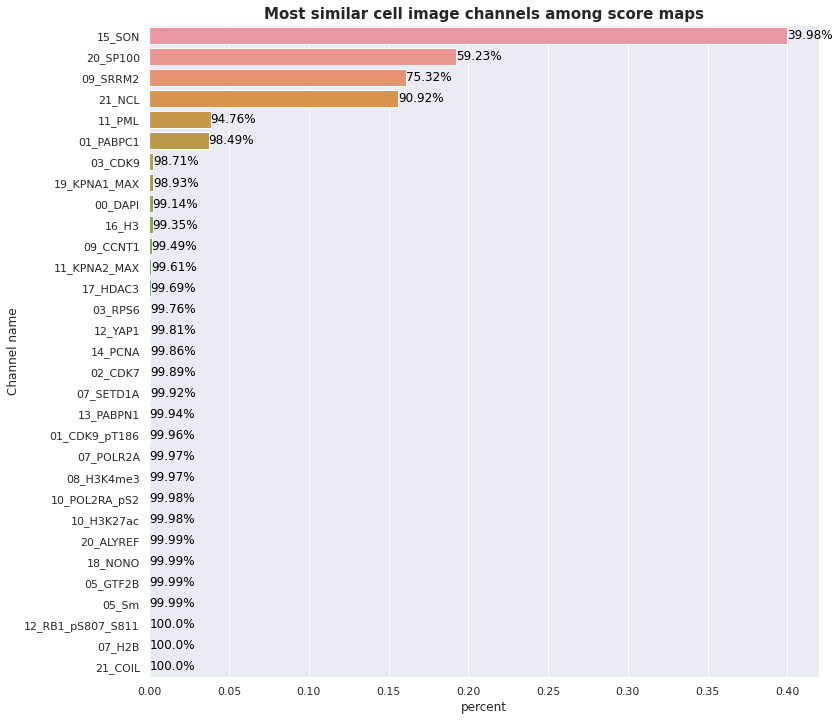

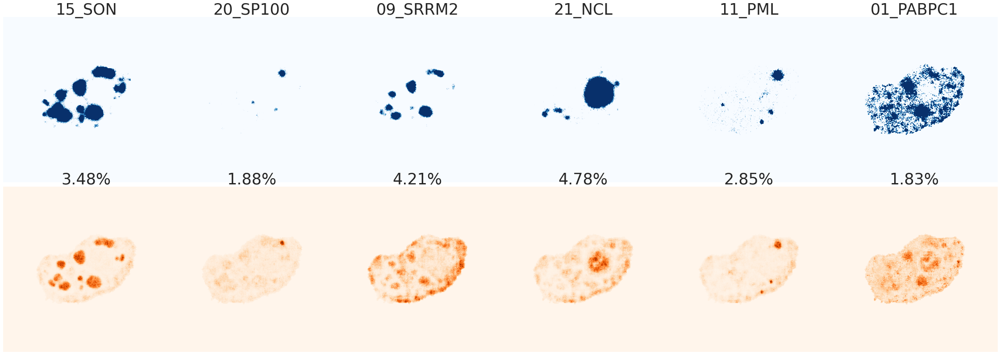

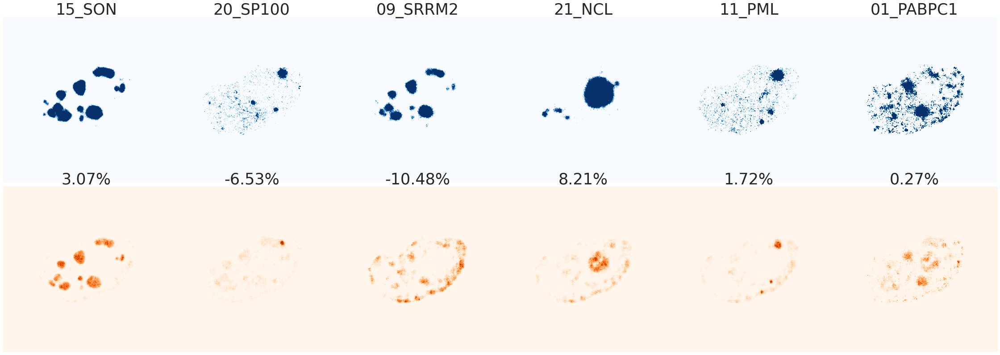

In [22]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_ci_dfs[0].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(12,12))
g = sns.barplot(data=channel_counts,
            y='name',
            x='percent',
            orient="h"
           )
plt.title('Most similar cell image channels among score maps', fontweight="bold", fontsize=15)
plt.ylabel('Channel name')
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.cum_percent,2))+'%'
    g.text(row['percent'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.985
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

# Original img and score map
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[ 7 13 17 26 19 18]


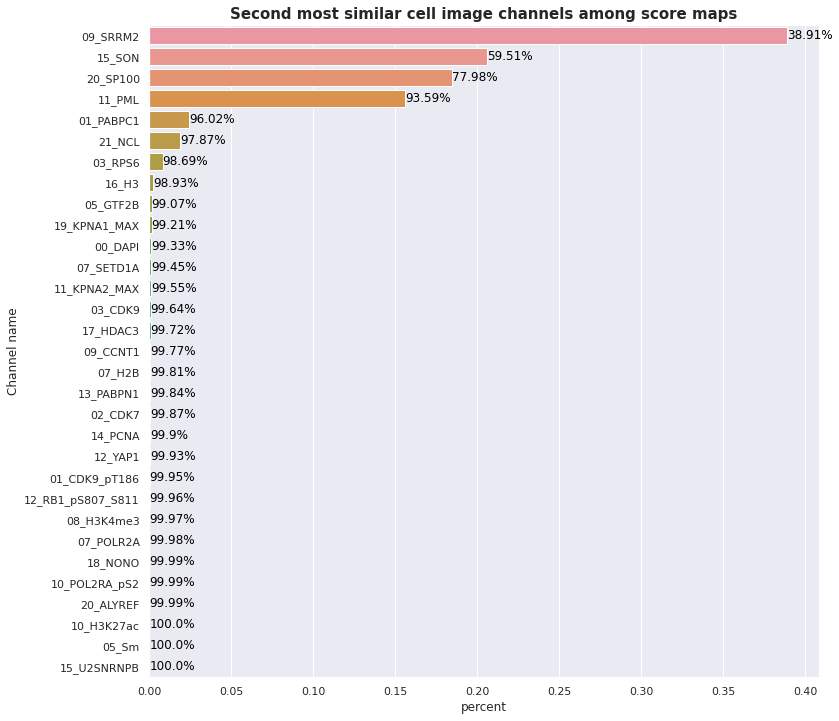

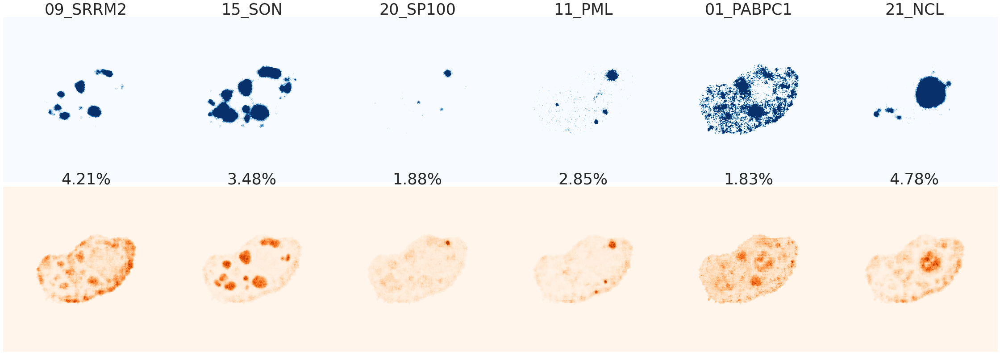

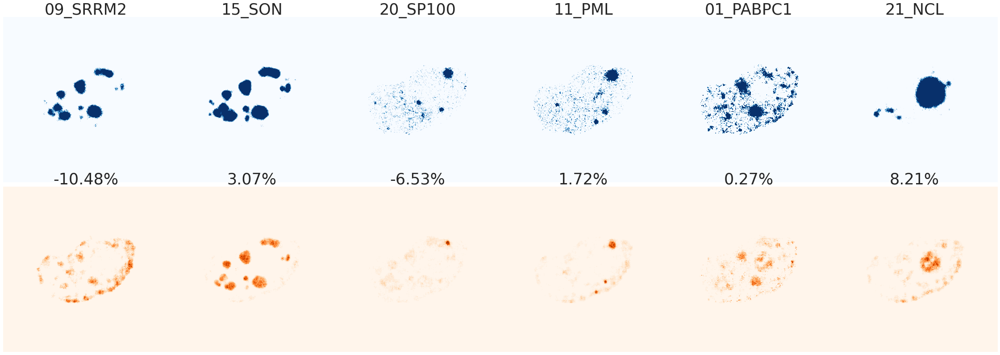

In [23]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_ci_dfs[1].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(12,12))
g = sns.barplot(data=channel_counts,
            y='name',
            x='percent',
            orient="h"
           )
plt.title('Second most similar cell image channels among score maps', fontweight="bold", fontsize=15)
plt.ylabel('Channel name')
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.cum_percent,2))+'%'
    g.text(row['percent'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.98
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

# Original img and score map
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[17 26 13 11 19  7 18 31  5  2 21  3 14 16]


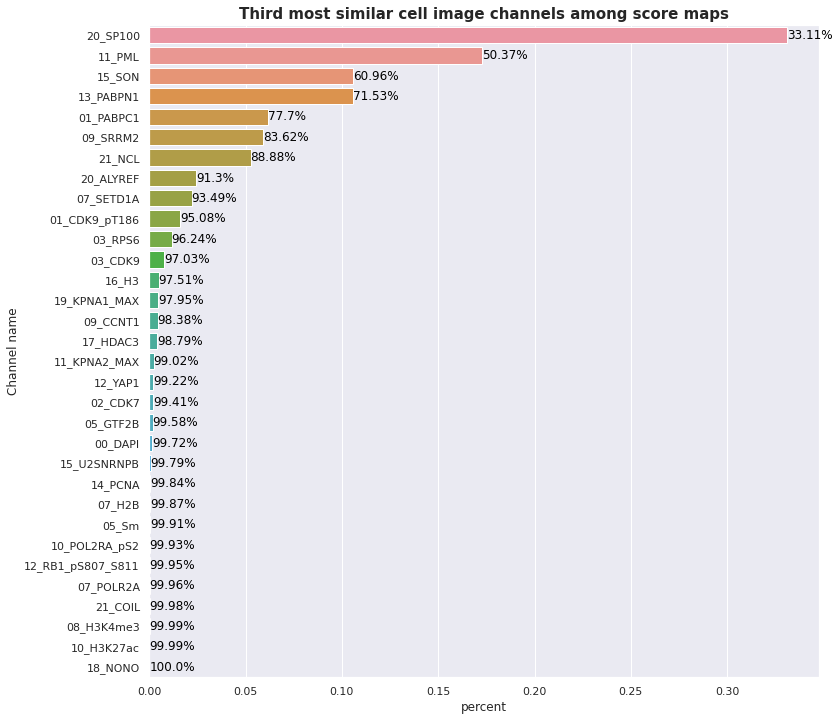

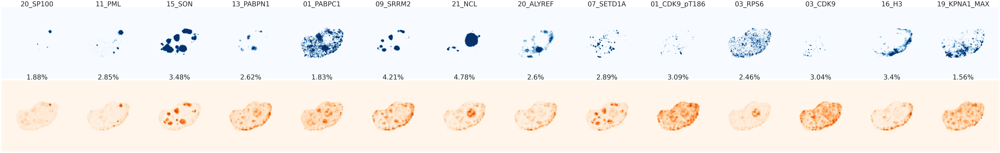

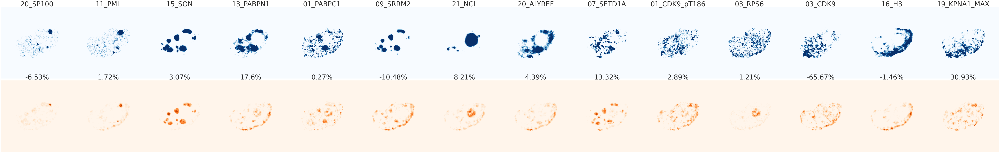

In [24]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_ci_dfs[2].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(12,12))
g = sns.barplot(data=channel_counts,
            y='name',
            x='percent',
            orient="h"
           )
plt.title('Third most similar cell image channels among score maps', fontweight="bold", fontsize=15)
plt.ylabel('Channel name')
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.cum_percent,2))+'%'
    g.text(row['percent'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.98
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

# Original img and score map
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

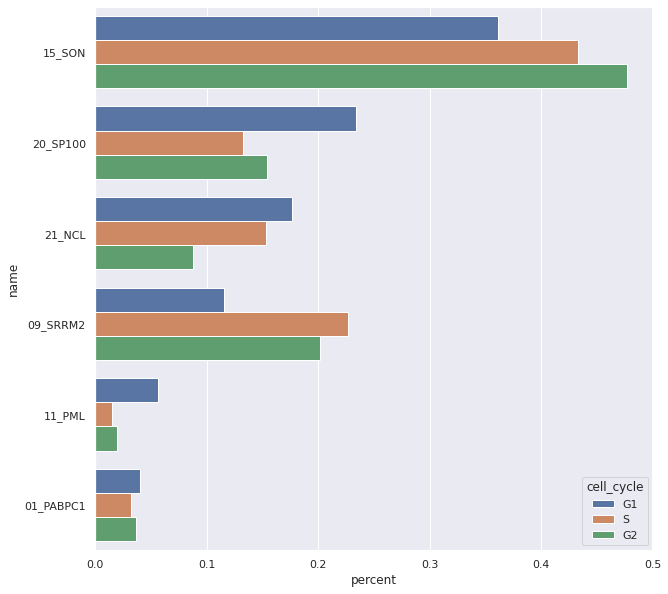

In [25]:
# Separated by cc
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_ci_dfs[0].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']
temp_df = temp_df.merge(score_map_stddev[['mapobject_id_cell', 'cell_cycle', 'TR_Level']],
                  left_on='mapobject_id_cell',
                   right_on='mapobject_id_cell',
                   how='left'
                  )

channel_counts_per_TRL = pd.DataFrame()
for cc in temp_df.cell_cycle.unique():
    mask = (temp_df.cell_cycle == cc)
    
    channel_counts = temp_df[mask]['idx'].copy()
    channel_counts = channel_counts.value_counts().reset_index()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['percent'] = channel_counts['count'] / total_counts
    channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
    channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                                 left_on='TFDS_channel_id',
                                 right_on='TFDS_channel_id',
                                 how='left'
                                )
    channel_counts['cell_cycle'] = cc
    channel_counts_per_TRL = pd.concat((channel_counts_per_TRL, channel_counts), axis=0, ignore_index=True)

# Show only top
total_counts = channel_counts_per_TRL['count'].sum()
temp2_df = channel_counts_per_TRL.groupby(['name']).sum().reset_index()
temp2_df = temp2_df.sort_values(by='count', ascending=False)
temp2_df['percent'] = temp2_df['count'] / total_counts
temp2_df['cum_percent'] = temp2_df['percent'].cumsum()
top_channels = temp2_df.head(6).name.values
mask = channel_counts_per_TRL.name.isin(top_channels)

filtered_df = channel_counts_per_TRL[mask].copy().reset_index()
    
plt.figure(figsize=(10,10))
g = sns.barplot(data=filtered_df,
            y='name',
            x='percent',
            orient="h",
            hue='cell_cycle',
            hue_order=['G1', 'S', 'G2']
           )

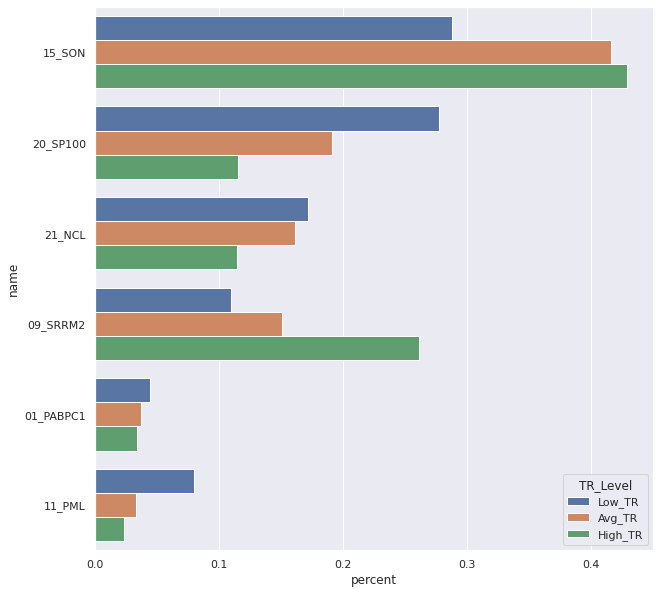

In [26]:
# Separated by cc
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_ci_dfs[0].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']
temp_df = temp_df.merge(score_map_stddev[['mapobject_id_cell', 'cell_cycle', 'TR_Level']],
                  left_on='mapobject_id_cell',
                   right_on='mapobject_id_cell',
                   how='left'
                  )

channel_counts_per_TRL = pd.DataFrame()
for trl in temp_df.TR_Level.unique():
    mask = (temp_df.TR_Level == trl)
    
    channel_counts = temp_df[mask]['idx'].copy()
    channel_counts = channel_counts.value_counts().reset_index()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['percent'] = channel_counts['count'] / total_counts
    channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
    channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                                 left_on='TFDS_channel_id',
                                 right_on='TFDS_channel_id',
                                 how='left'
                                )
    channel_counts['TR_Level'] = trl
    channel_counts_per_TRL = pd.concat((channel_counts_per_TRL, channel_counts), axis=0, ignore_index=True)

# Show only top
total_counts = channel_counts_per_TRL['count'].sum()
temp2_df = channel_counts_per_TRL.groupby(['name']).sum().reset_index()
temp2_df = temp2_df.sort_values(by='count', ascending=False)
temp2_df['percent'] = temp2_df['count'] / total_counts
temp2_df['cum_percent'] = temp2_df['percent'].cumsum()
top_channels = temp2_df.head(6).name.values
mask = channel_counts_per_TRL.name.isin(top_channels)

filtered_df = channel_counts_per_TRL[mask].copy().reset_index()
    
plt.figure(figsize=(10,10))
g = sns.barplot(data=filtered_df,
            y='name',
            x='percent',
            orient="h",
            hue='TR_Level',
            hue_order=['Low_TR', 'Avg_TR', 'High_TR']
           )

In [27]:
channel_counts

,TFDS_channel_id,count,percent,cum_percent,name,TR_Level
0,13.0,6913,0.429272,0.429272,15_SON,High_TR
1,7.0,4211,0.261488,0.690760,09_SRRM2,High_TR
2,17.0,1861,0.115561,0.806321,20_SP100,High_TR
3,18.0,1843,0.114444,0.920765,21_NCL,High_TR
4,19.0,539,0.033470,0.954235,01_PABPC1,High_TR
5,26.0,372,0.023100,0.977335,11_PML,High_TR
6,3.0,82,0.005092,0.982427,03_CDK9,High_TR
7,24.0,72,0.004471,0.986898,09_CCNT1,High_TR
8,0.0,38,0.002360,0.989257,00_DAPI,High_TR
9,16.0,26,0.001615,0.990872,19_KPNA1_MAX,High_TR


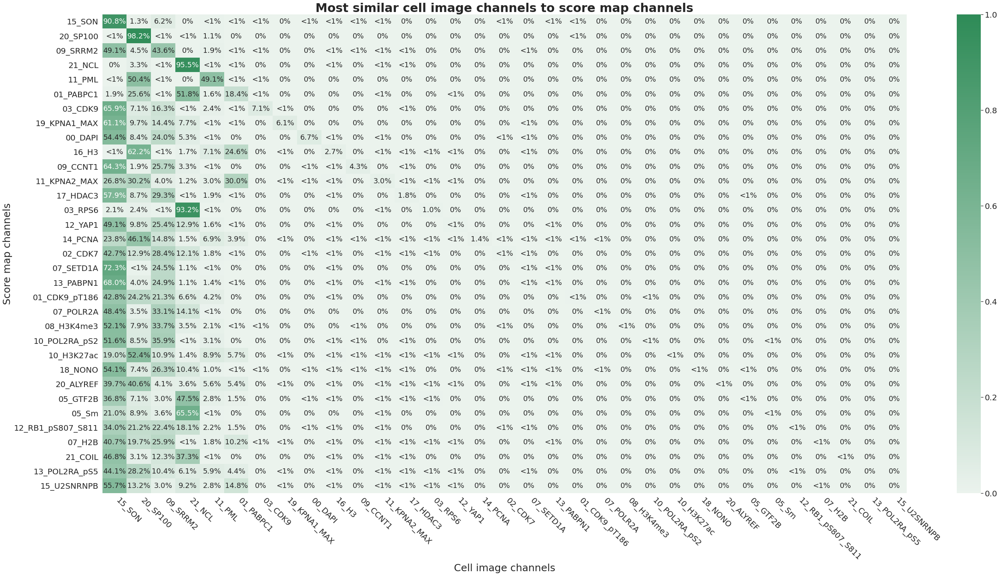

In [37]:
percents_df = pd.DataFrame(columns=['channel_name']+list(input_ids))

for c in input_channel_names:
    temp_df = top_sm_to_ci_dfs[0]
    temp_df = temp_df[c+'_idx'].copy()
    channel_counts = temp_df.value_counts().reset_index()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['percent'] = channel_counts['count'] / total_counts
    channel_counts.TFDS_channel_id = channel_counts.TFDS_channel_id.astype('int16')
    
    # use input_ids instead of input_channel_names as columns since pivot sort the rows
    temp_df = pd.DataFrame(input_ids, columns=['TFDS_channel_id'])
    temp_df['percent'] = 0
    temp_df['channel_name'] = c
    idxs = channel_counts.TFDS_channel_id.values
    percents = channel_counts.percent.values
    temp_df.loc[idxs, 'percent'] = percents
    temp_df = temp_df.pivot(index='channel_name', columns='TFDS_channel_id', values='percent').reset_index()
    
    percents_df = pd.concat((percents_df, temp_df), axis=0, ignore_index=True)

# set channel_names as column names
percents_df.columns = ['channel_name']+list(input_channel_names)
# set channel_name as index
percents_df = percents_df.set_index('channel_name')
# sort dataframe
sorted_col_idxs = np.argsort(-percents_df.values.sum(axis=0))
percents_df = percents_df.iloc[sorted_col_idxs,sorted_col_idxs]

# create annotation df for a better view
annotations_df = percents_df.copy()
values_array = percents_df.values * 100
for i in range(values_array.shape[0]):
    for j in range(values_array.shape[0]):
        value = values_array[i,j]
        if (value < 1) and (value > 0):
            annotations_df.iloc[i,j] = '<1%'
        elif value == 0:
            annotations_df.iloc[i,j] = '0%'
        elif value < 10:
            annotations_df.iloc[i,j] = str(value)[0:3]+'%'
        else:
            annotations_df.iloc[i,j] = str(value)[0:4]+'%'

fig = plt.figure(figsize=(45, 22))
cmap = sns.light_palette("seagreen", reverse=False, as_cmap=True)
#cmap = sns.diverging_palette(220, 20, sep=20, as_cmap=True)
ax = sns.heatmap(data=percents_df,
            annot=annotations_df,
            annot_kws={'fontsize':18},#'fontweight':'bold'},
            fmt='',
            vmin=0, vmax=1,
            cmap=cmap
           )
# use matplotlib.colorbar.Colorbar object
cbar = ax.collections[0].colorbar
# here set the labelsize by 20
cbar.ax.tick_params(labelsize=20)
_ = plt.title('Most similar cell image channels to score map channels', fontweight='bold', fontsize=30)
_ = plt.ylabel('Score map channels', fontsize=25)
_ = plt.xlabel('Cell image channels', fontsize=25)
plt.yticks(fontsize=20)
plt.xticks(rotation=-45, rotation_mode='default', horizontalalignment='left', fontsize=20)
fig.savefig('./temp.jpg', bbox_inches='tight', pad_inches=0)

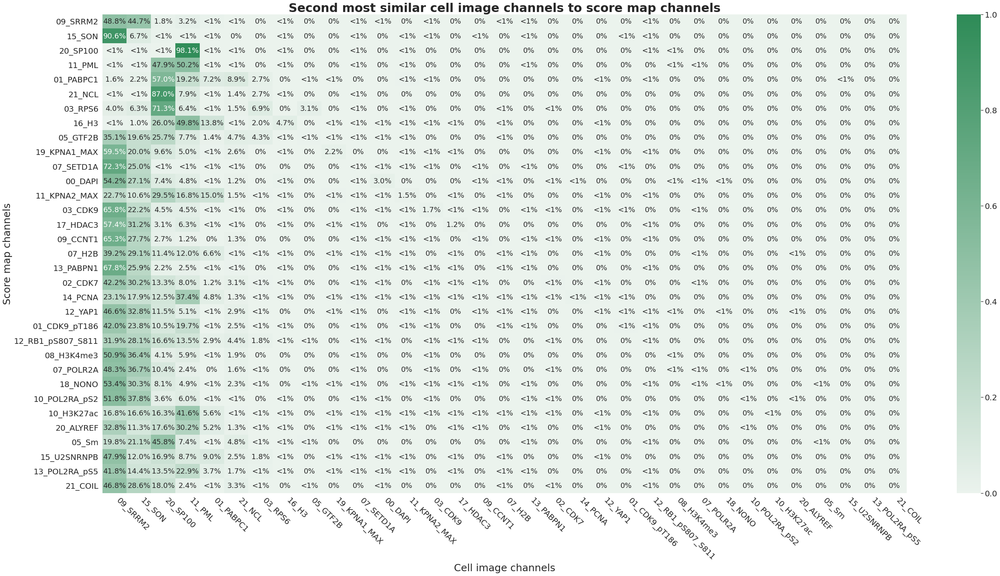

In [38]:
percents_df = pd.DataFrame(columns=['channel_name']+list(input_ids))

for c in input_channel_names:
    temp_df = top_sm_to_ci_dfs[1]
    temp_df = temp_df[c+'_idx'].copy()
    channel_counts = temp_df.value_counts().reset_index()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['percent'] = channel_counts['count'] / total_counts
    channel_counts.TFDS_channel_id = channel_counts.TFDS_channel_id.astype('int16')
    
    # use input_ids instead of input_channel_names as columns since pivot sort the rows
    temp_df = pd.DataFrame(input_ids, columns=['TFDS_channel_id'])
    temp_df['percent'] = 0
    temp_df['channel_name'] = c
    idxs = channel_counts.TFDS_channel_id.values
    percents = channel_counts.percent.values
    temp_df.loc[idxs, 'percent'] = percents
    temp_df = temp_df.pivot(index='channel_name', columns='TFDS_channel_id', values='percent').reset_index()
    
    percents_df = pd.concat((percents_df, temp_df), axis=0, ignore_index=True)

# set channel_names as column names
percents_df.columns = ['channel_name']+list(input_channel_names)
# set channel_name as index
percents_df = percents_df.set_index('channel_name')
# sort dataframe
sorted_col_idxs = np.argsort(-percents_df.values.sum(axis=0))
percents_df = percents_df.iloc[sorted_col_idxs,sorted_col_idxs]

# create annotation df for a better view
annotations_df = percents_df.copy()
values_array = percents_df.values * 100
for i in range(values_array.shape[0]):
    for j in range(values_array.shape[0]):
        value = values_array[i,j]
        if (value < 1) and (value > 0):
            annotations_df.iloc[i,j] = '<1%'
        elif value == 0:
            annotations_df.iloc[i,j] = '0%'
        elif value < 10:
            annotations_df.iloc[i,j] = str(value)[0:3]+'%'
        else:
            annotations_df.iloc[i,j] = str(value)[0:4]+'%'

fig = plt.figure(figsize=(45, 22))
cmap = sns.light_palette("seagreen", reverse=False, as_cmap=True)
#cmap = sns.diverging_palette(220, 20, sep=20, as_cmap=True)
ax = sns.heatmap(data=percents_df,
            annot=annotations_df,
            annot_kws={'fontsize':18},#'fontweight':'bold'},
            fmt='',
            vmin=0, vmax=1,
            cmap=cmap
           )
# use matplotlib.colorbar.Colorbar object
cbar = ax.collections[0].colorbar
# here set the labelsize by 20
cbar.ax.tick_params(labelsize=20)
_ = plt.title('Second most similar cell image channels to score map channels', fontweight='bold', fontsize=30)
_ = plt.ylabel('Score map channels', fontsize=25)
_ = plt.xlabel('Cell image channels', fontsize=25)
plt.yticks(fontsize=20)
plt.xticks(rotation=-45, rotation_mode='default', horizontalalignment='left', fontsize=20)
fig.savefig('./temp.jpg', bbox_inches='tight', pad_inches=0)

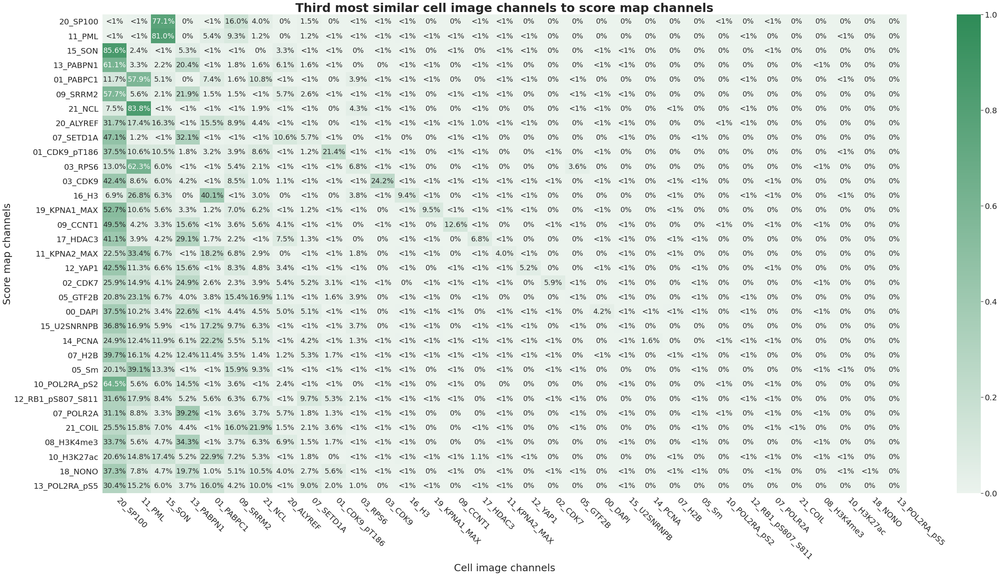

In [39]:
percents_df = pd.DataFrame(columns=['channel_name']+list(input_ids))

for c in input_channel_names:
    temp_df = top_sm_to_ci_dfs[2]
    temp_df = temp_df[c+'_idx'].copy()
    channel_counts = temp_df.value_counts().reset_index()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['percent'] = channel_counts['count'] / total_counts
    channel_counts.TFDS_channel_id = channel_counts.TFDS_channel_id.astype('int16')
    
    # use input_ids instead of input_channel_names as columns since pivot sort the rows
    temp_df = pd.DataFrame(input_ids, columns=['TFDS_channel_id'])
    temp_df['percent'] = 0
    temp_df['channel_name'] = c
    idxs = channel_counts.TFDS_channel_id.values
    percents = channel_counts.percent.values
    temp_df.loc[idxs, 'percent'] = percents
    temp_df = temp_df.pivot(index='channel_name', columns='TFDS_channel_id', values='percent').reset_index()
    
    percents_df = pd.concat((percents_df, temp_df), axis=0, ignore_index=True)

# set channel_names as column names
percents_df.columns = ['channel_name']+list(input_channel_names)
# set channel_name as index
percents_df = percents_df.set_index('channel_name')
# sort dataframe
sorted_col_idxs = np.argsort(-percents_df.values.sum(axis=0))
percents_df = percents_df.iloc[sorted_col_idxs,sorted_col_idxs]

# create annotation df for a better view
annotations_df = percents_df.copy()
values_array = percents_df.values * 100
for i in range(values_array.shape[0]):
    for j in range(values_array.shape[0]):
        value = values_array[i,j]
        if (value < 1) and (value > 0):
            annotations_df.iloc[i,j] = '<1%'
        elif value == 0:
            annotations_df.iloc[i,j] = '0%'
        elif value < 10:
            annotations_df.iloc[i,j] = str(value)[0:3]+'%'
        else:
            annotations_df.iloc[i,j] = str(value)[0:4]+'%'

fig = plt.figure(figsize=(45, 22))
cmap = sns.light_palette("seagreen", reverse=False, as_cmap=True)
#cmap = sns.diverging_palette(220, 20, sep=20, as_cmap=True)
ax = sns.heatmap(data=percents_df,
            annot=annotations_df,
            annot_kws={'fontsize':18},#'fontweight':'bold'},
            fmt='',
            vmin=0, vmax=1,
            cmap=cmap
           )
# use matplotlib.colorbar.Colorbar object
cbar = ax.collections[0].colorbar
# here set the labelsize by 20
cbar.ax.tick_params(labelsize=20)
_ = plt.title('Third most similar cell image channels to score map channels', fontweight='bold', fontsize=30)
_ = plt.ylabel('Score map channels', fontsize=25)
_ = plt.xlabel('Cell image channels', fontsize=25)
plt.yticks(fontsize=20)
plt.xticks(rotation=-45, rotation_mode='default', horizontalalignment='left', fontsize=20)
fig.savefig('./temp.jpg', bbox_inches='tight', pad_inches=0)

<ipython-input-29-4369f39f567b>:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))


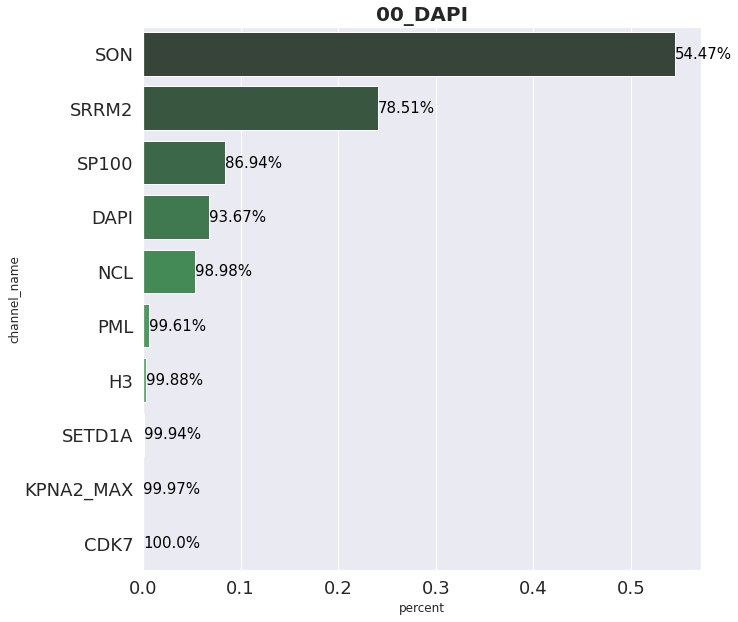

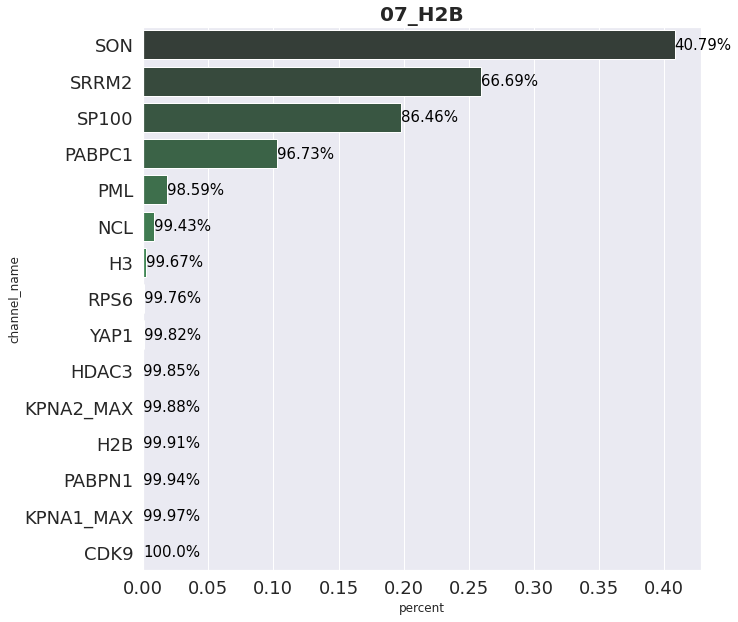

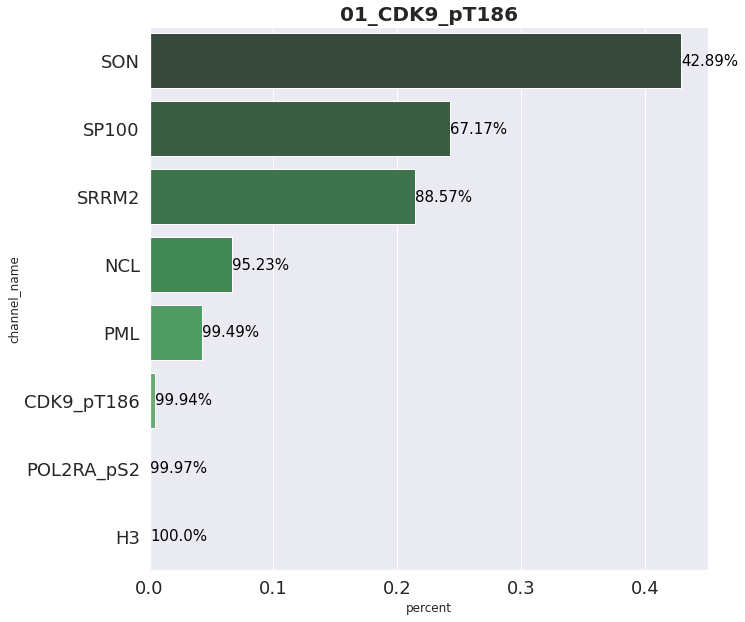

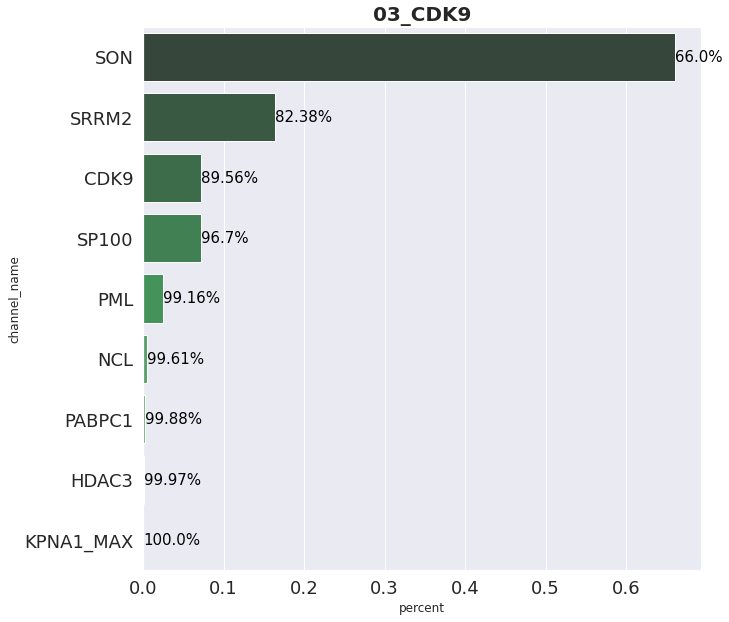

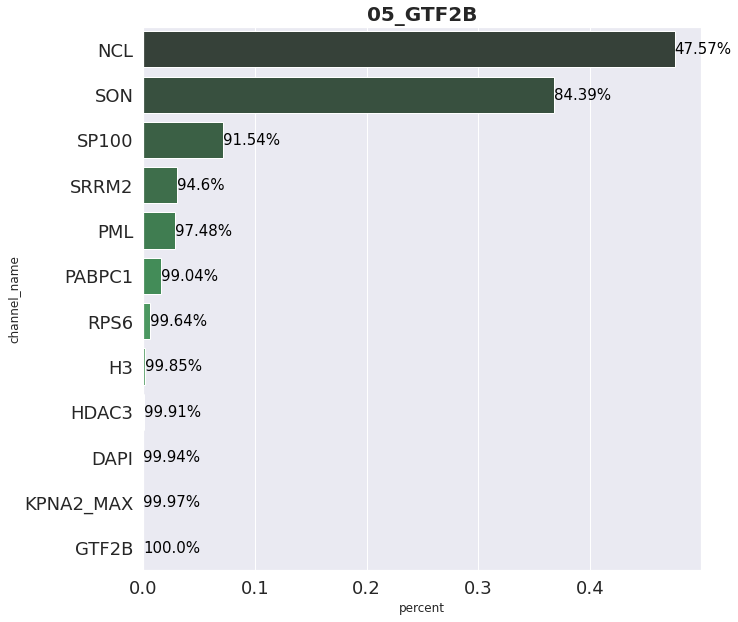

...

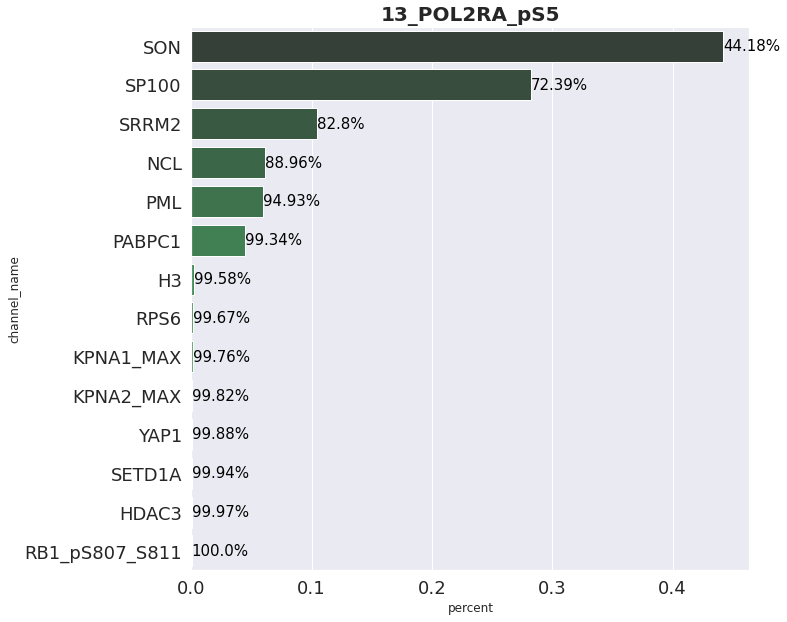

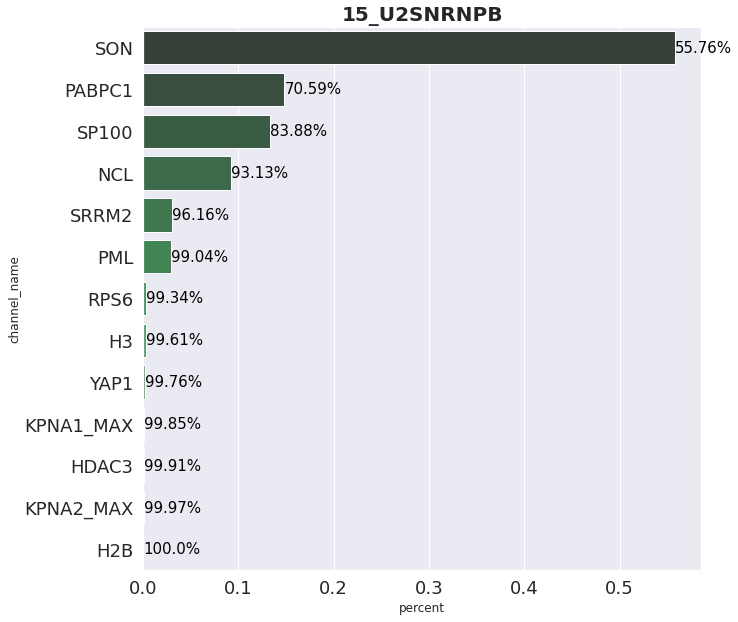

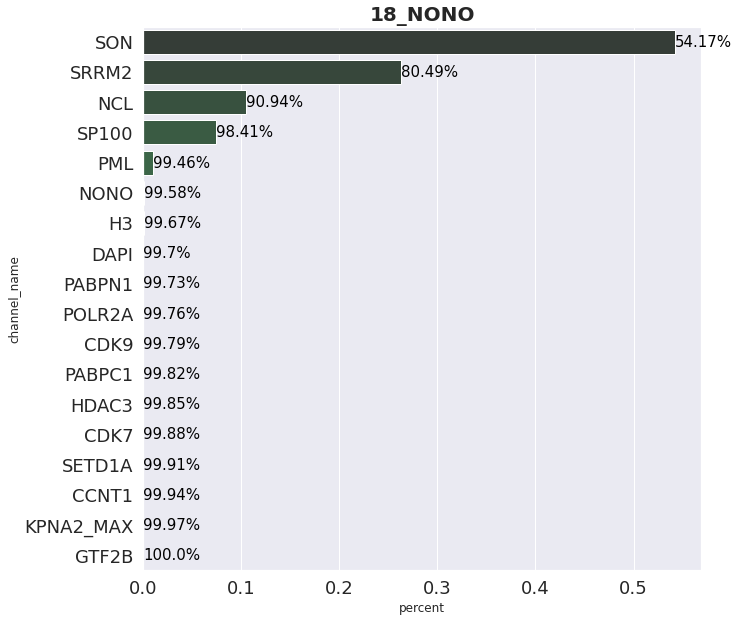

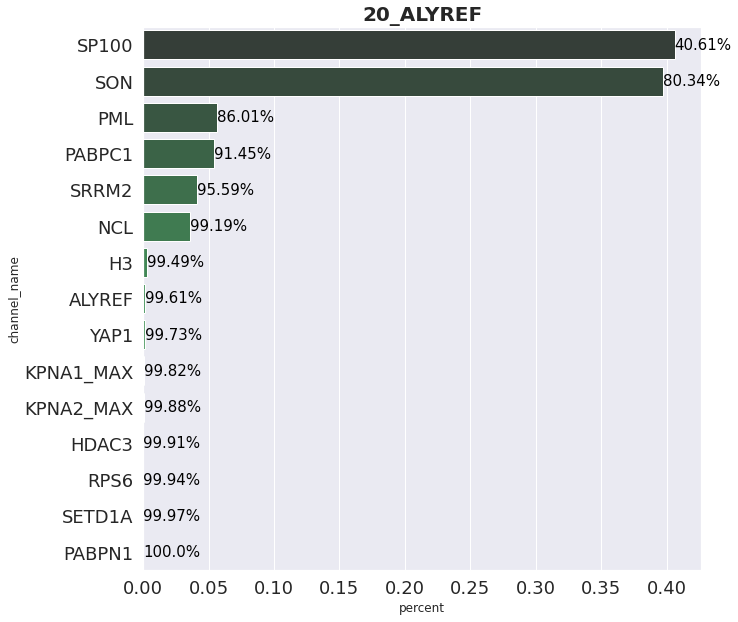

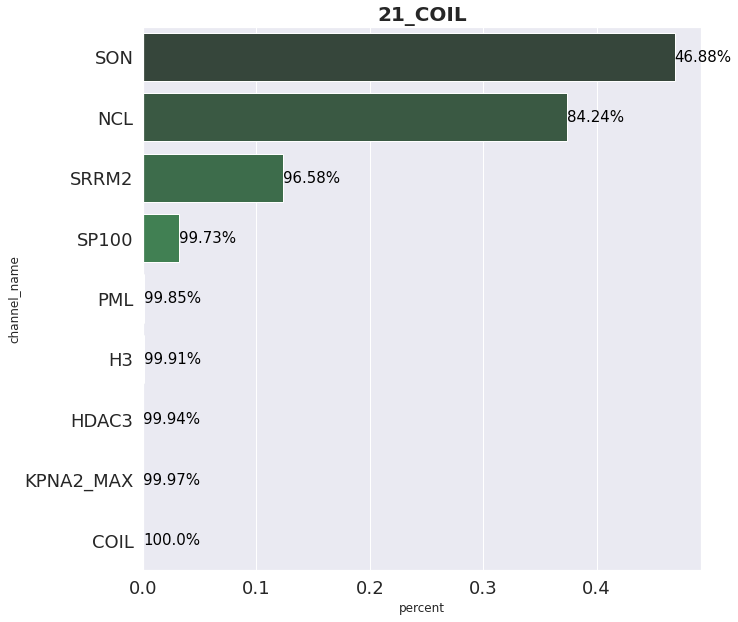

In [29]:
for c in input_channel_names:
    temp_df = top_sm_to_ci_dfs[0]
    temp_df = temp_df[c+'_idx'].copy()
    channel_counts = temp_df.value_counts().reset_index()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['percent'] = channel_counts['count'] / total_counts
    channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
    channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'channel_name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )
    channel_counts.TFDS_channel_id = channel_counts.TFDS_channel_id.astype('int16')
    
    plt.figure(figsize=(10,10))
    pal = sns.color_palette("Greens_d", channel_counts.shape[0])
    g = sns.barplot(data=channel_counts,
                    y='channel_name',
                    x='percent',
                    palette=np.array(pal[::-1]),
                    orient="h"
                   )
    plt.xticks(fontsize=18)
    plt.yticks(fontsize=18)
    
    plt.title(c, fontweight="bold", fontsize=20)
    # add per cents
    for _, row in channel_counts.iterrows():
        g.text(row['percent'], row.name, str(round(100 * row.cum_percent,2))+'%', color='black', ha="left", va="center", fontsize=15)
        
    plt.savefig('./Plot/'+c+'.jpg', bbox_inches='tight', pad_inches=0)


# Similarity between score_maps channels and score_maps chanels

[11  5  9 22 31 29 21 28  7 18  4 23 25 14 30 26  6 17 32 12 13  1  8]


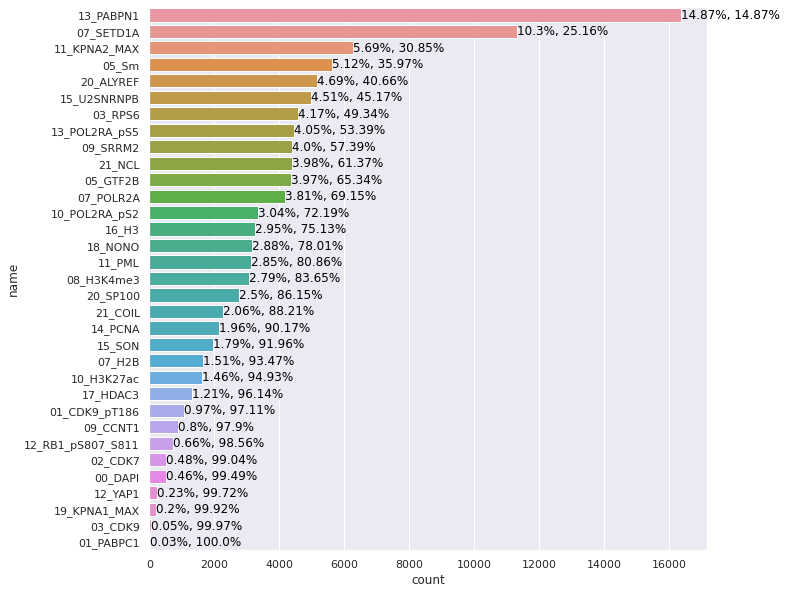

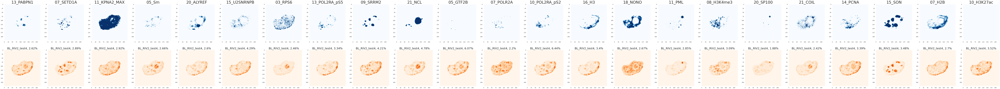

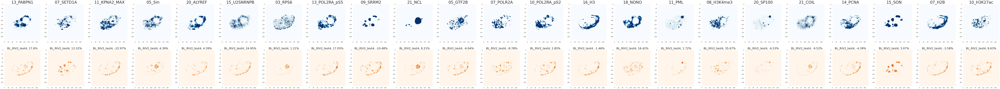

In [38]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_sm_dfs[0].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(10,10))
g = sns.barplot(data=channel_counts,
            y='name',
            x='count',
            orient="h"
           )
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.percent,2))+'%, '+str(round(100 * row.cum_percent,2))+'%'
    g.text(row['count'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.95
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[11  5 25 22  7 23 29 31  9 28  4 18 15 30 14 21  6 12 13 32  2  8  1]


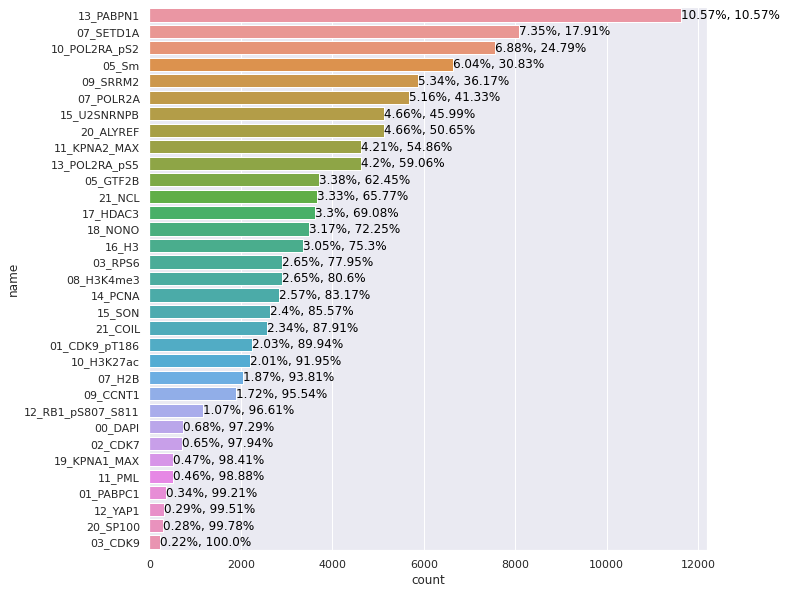

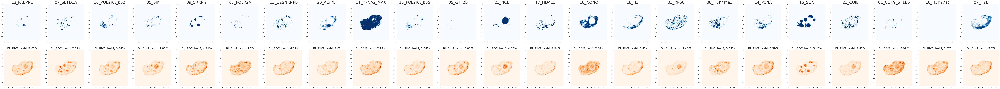

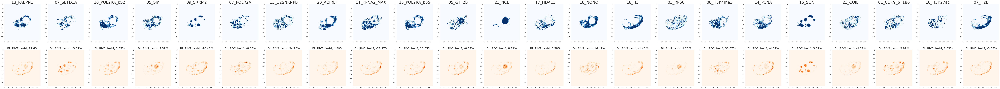

In [39]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_sm_dfs[1].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(10,10))
g = sns.barplot(data=channel_counts,
            y='name',
            x='count',
            orient="h"
           )
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.percent,2))+'%, '+str(round(100 * row.cum_percent,2))+'%'
    g.text(row['count'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.95
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[23 11 15  5 25  7  4 29 31 28 32 30  9 13  2  6 14  8  1 12 22 21 19 24
 18]


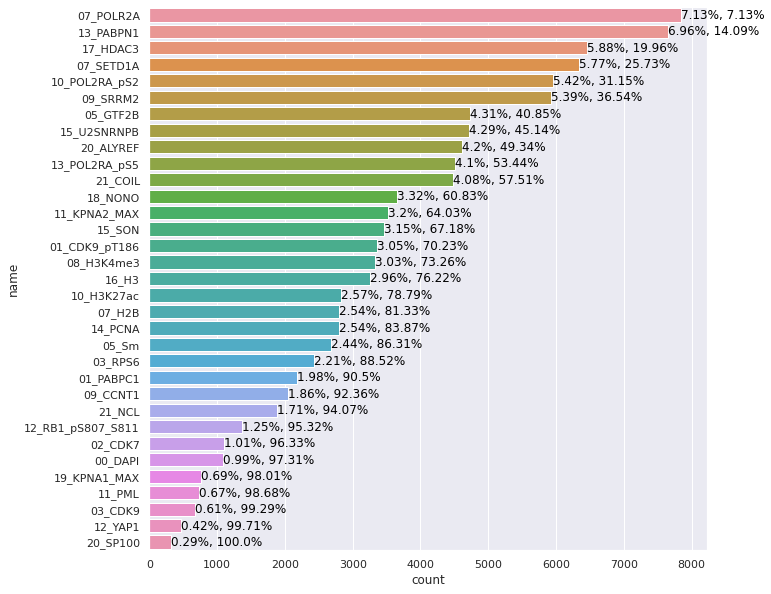

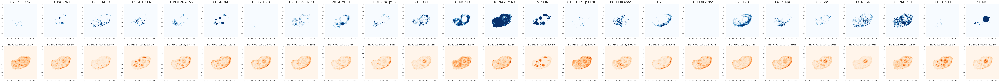

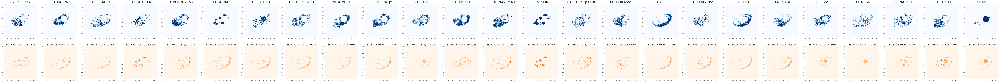

In [37]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_sm_dfs[2].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(10,10))
g = sns.barplot(data=channel_counts,
            y='name',
            x='count',
            orient="h"
           )
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.percent,2))+'%, '+str(round(100 * row.cum_percent,2))+'%'
    g.text(row['count'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.95
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

<ipython-input-35-f7ed56775a48>:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))


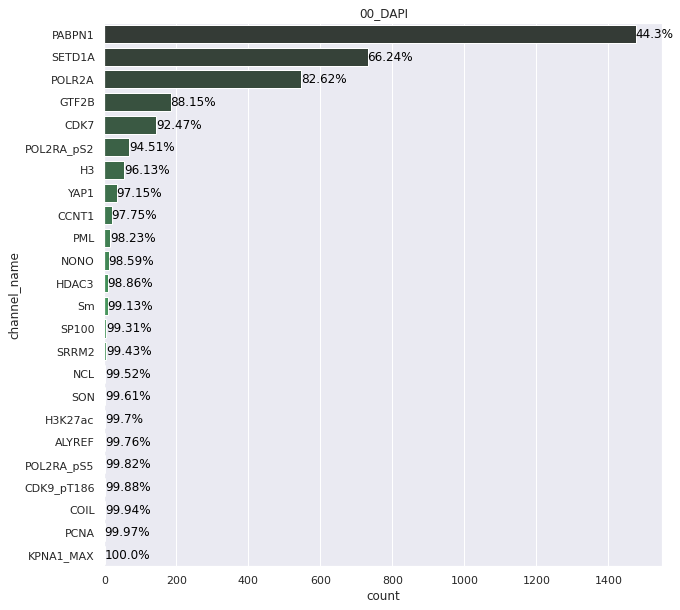

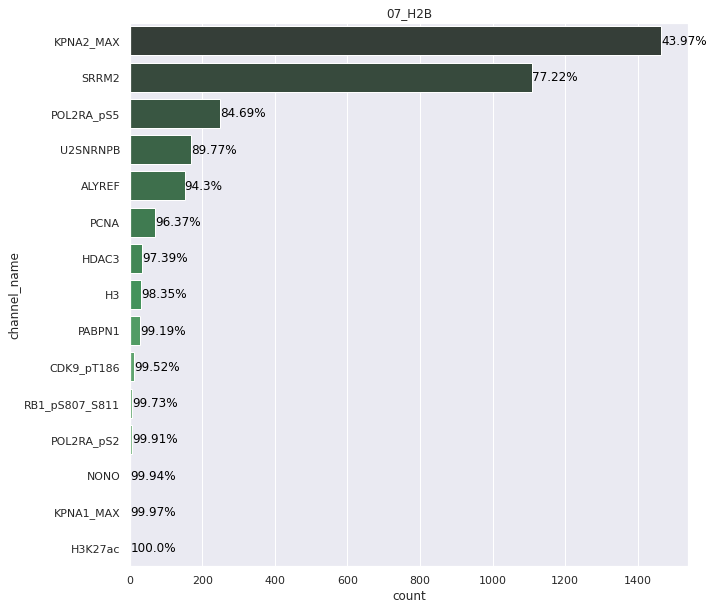

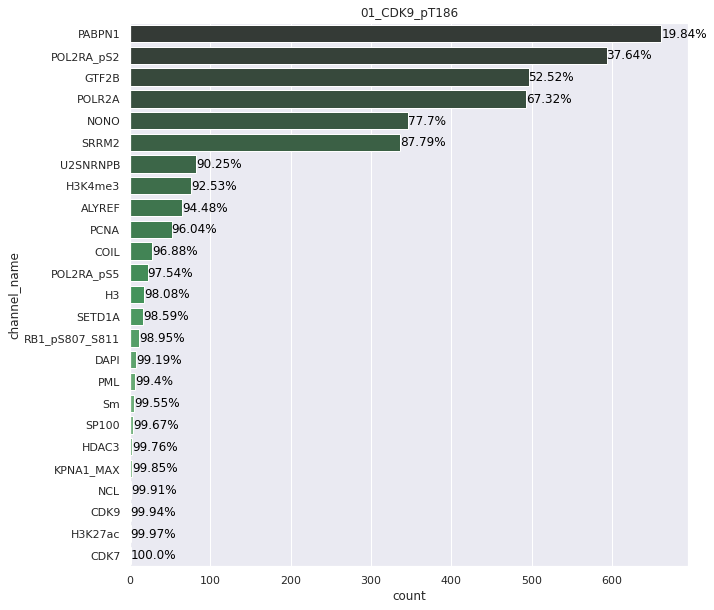

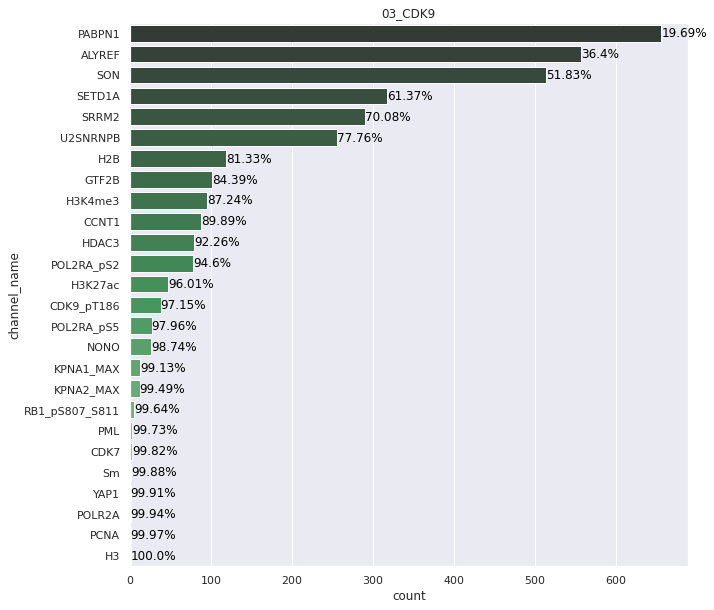

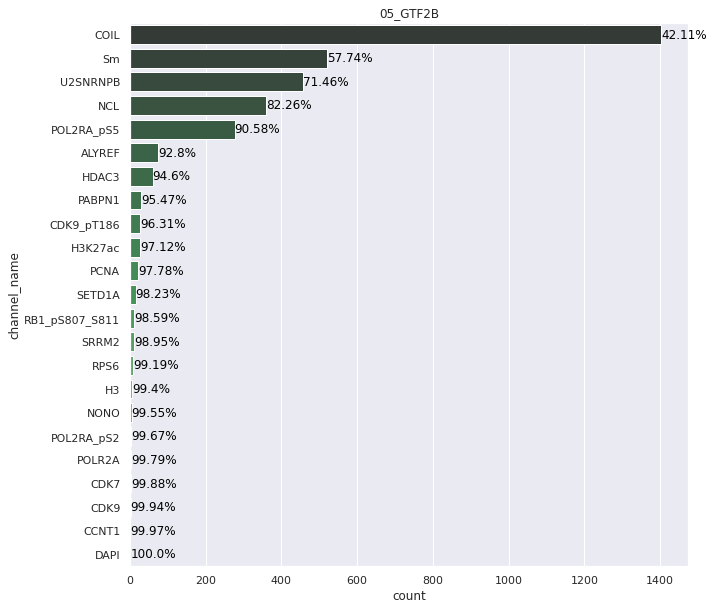

...

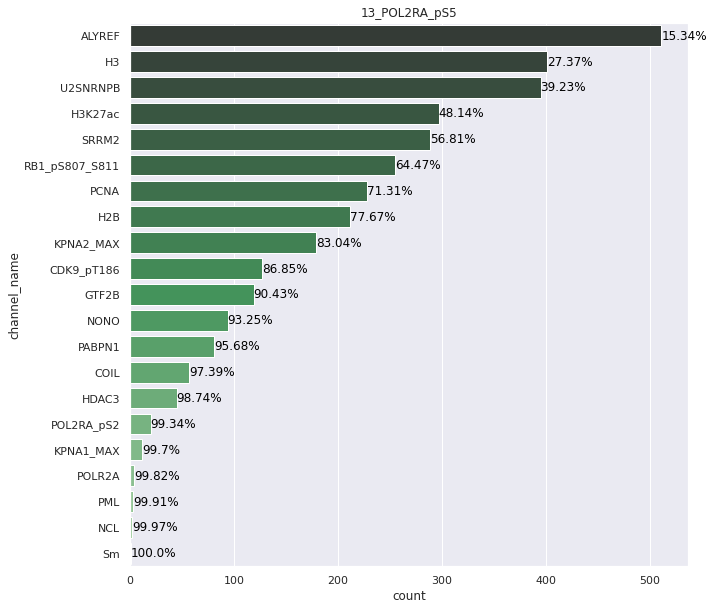

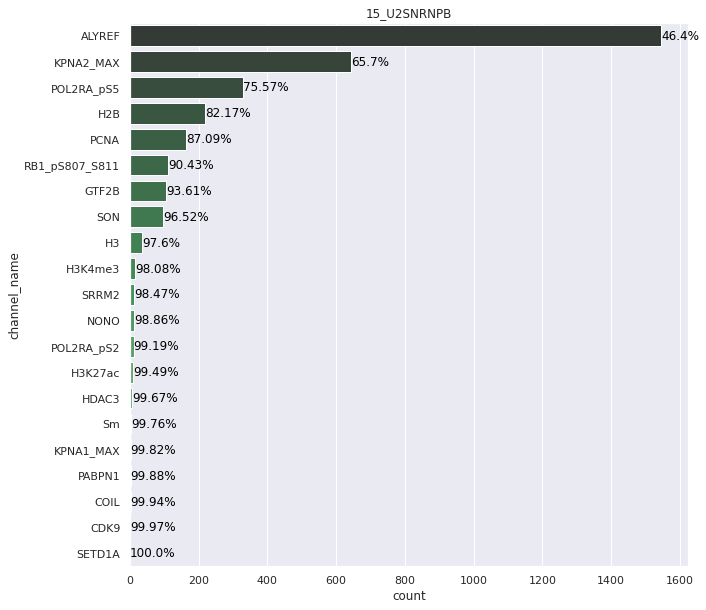

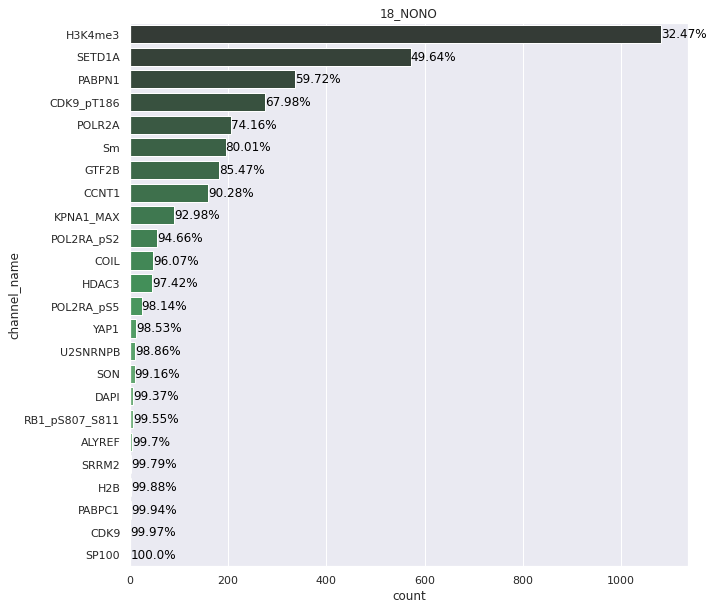

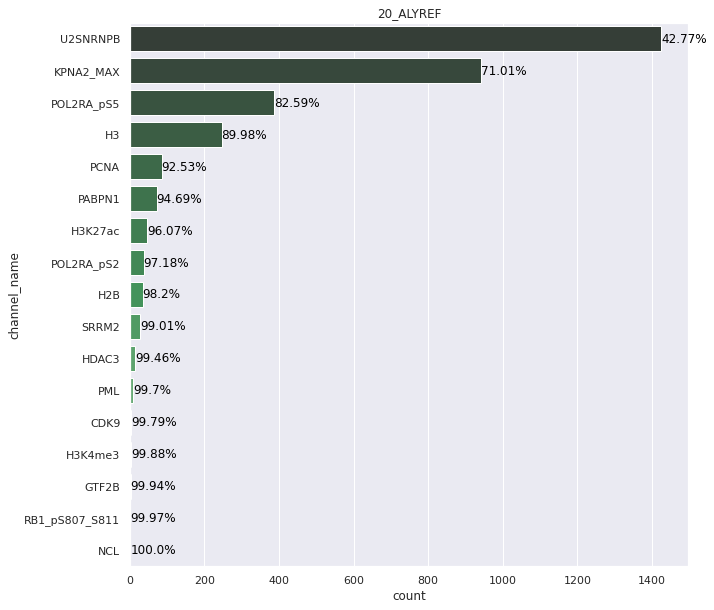

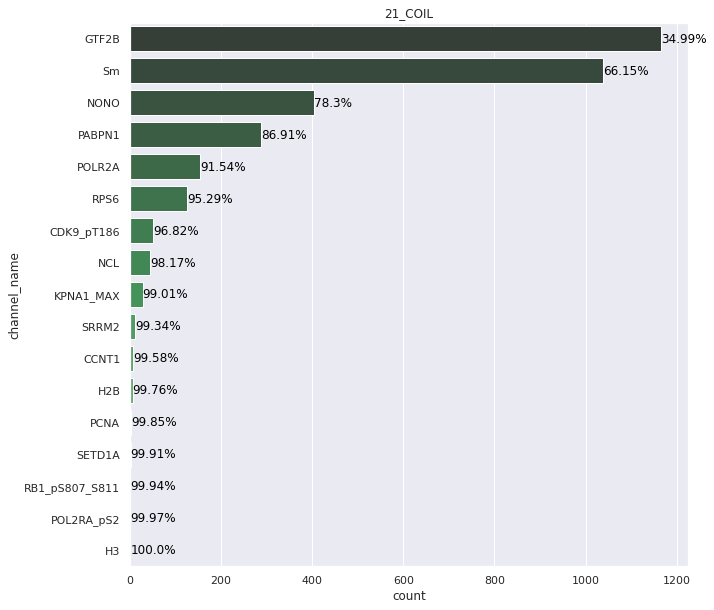

In [35]:
for c in input_channel_names:
    temp_df = top_sm_to_sm_dfs[0].copy()
    temp_df = temp_df[c+'_idx'].copy()
    channel_counts = temp_df.value_counts().reset_index()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
    channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'channel_name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )
    plt.figure(figsize=(10,10))
    pal = sns.color_palette("Greens_d", channel_counts.shape[0])
    g = sns.barplot(data=channel_counts,
                    y='channel_name',
                    x='count',
                    palette=np.array(pal[::-1]),
                    orient="h"
                   )
    plt.title(c)
    # add per cents
    for _, row in channel_counts.iterrows():
        g.text(row['count'], row.name, str(round(100 * row.cum_percent,2))+'%', color='black', ha="left", va="center")
